In [1]:
import torch.multiprocessing as mp
from multiprocessing.context import SpawnContext
from torch.multiprocessing.spawn import ProcessContext

import pandas as pd
import cv2
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import os
import time
import copy
from typing import Optional, Callable, List, Union
from random import randrange, shuffle
from sklearn.model_selection import train_test_split
import sys, importlib
import inspect
import queue

from torch.multiprocessing import Queue, Event
from torch.utils.data import DataLoader, IterableDataset
from torchvision import models, transforms
import torch.nn as nn
import torch
from torch.optim import lr_scheduler
import torch.optim as optim

matplotlib.rcParams['figure.figsize'] = (10.0, 10.0)

In [2]:
df_train = pd.read_csv('../input/train.csv')
files = os.listdir('../input/train/')
df_files = pd.DataFrame(files, columns=['file_name'])
df_files[['id', 'color']] = df_files['file_name']\
    .str.split('_', expand=True)\
    .rename({0: 'id', 1: 'color'}, axis='columns')
df_files['color'] = df_files['color'].str.split('.', expand=True)[0]
df_files.columns = ['id', 'file_name', 'color']

temp = df_files[['file_name']].drop_duplicates('file_name')
for color in df_files['color'].unique():
    temp.loc[:, color] = df_files['file_name'] + '_'+color+'.png'
df_files = temp
df_files.rename({'file_name': 'id'}, axis='columns', inplace=True)
df_files = df_files.reset_index(drop=True)
df_files = df_files.merge(df_train, 'left', left_on='id', right_on='ID').drop('ID', axis='columns')
df_files.rename({'Label': 'label'}, axis='columns', inplace=True)
df_files['nr_of_labels'] = df_files['label'].str.split('|').apply(len)

In [3]:
def read_img(_id: str):
    t = df_files[df_files['id'] == _id].iloc[0]
    blue = cv2.imread('../input/train/{}'.format(t['blue']), 0)
    green = cv2.imread('../input/train/{}'.format(t['green']), 0)
    red = cv2.imread('../input/train/{}'.format(t['red']), 0)
    yellow = cv2.imread('../input/train/{}'.format(t['yellow']), 0)
    return {
        'blue': blue,
        'green': green,
        'red': red,
        'yellow': yellow,
        'labels': np.sort([int(x, 10) for x in t['label'].split('|')])
    }
    return blue

In [4]:
df_files.head()

,id,blue,green,red,yellow,label,nr_of_labels
0,000a6c98-bb9b-11e8-b2b9-ac1f6b6435d0,000a6c98-bb9b-11e8-b2b9-ac1f6b6435d0_blue.png,000a6c98-bb9b-11e8-b2b9-ac1f6b6435d0_green.png,000a6c98-bb9b-11e8-b2b9-ac1f6b6435d0_red.png,000a6c98-bb9b-11e8-b2b9-ac1f6b6435d0_yellow.png,7|1|2|0,4
1,000a9596-bbc4-11e8-b2bc-ac1f6b6435d0,000a9596-bbc4-11e8-b2bc-ac1f6b6435d0_blue.png,000a9596-bbc4-11e8-b2bc-ac1f6b6435d0_green.png,000a9596-bbc4-11e8-b2bc-ac1f6b6435d0_red.png,000a9596-bbc4-11e8-b2bc-ac1f6b6435d0_yellow.png,5,1
2,000c99ba-bba4-11e8-b2b9-ac1f6b6435d0,000c99ba-bba4-11e8-b2b9-ac1f6b6435d0_blue.png,000c99ba-bba4-11e8-b2b9-ac1f6b6435d0_green.png,000c99ba-bba4-11e8-b2b9-ac1f6b6435d0_red.png,000c99ba-bba4-11e8-b2b9-ac1f6b6435d0_yellow.png,1,1
3,001838f8-bbca-11e8-b2bc-ac1f6b6435d0,001838f8-bbca-11e8-b2bc-ac1f6b6435d0_blue.png,001838f8-bbca-11e8-b2bc-ac1f6b6435d0_green.png,001838f8-bbca-11e8-b2bc-ac1f6b6435d0_red.png,001838f8-bbca-11e8-b2bc-ac1f6b6435d0_yellow.png,12,1
4,0020af02-bbba-11e8-b2ba-ac1f6b6435d0,0020af02-bbba-11e8-b2ba-ac1f6b6435d0_blue.png,0020af02-bbba-11e8-b2ba-ac1f6b6435d0_green.png,0020af02-bbba-11e8-b2ba-ac1f6b6435d0_red.png,0020af02-bbba-11e8-b2ba-ac1f6b6435d0_yellow.png,16|2,2


In [5]:
df_files[df_files['nr_of_labels'] == 1]['label'].value_counts()

0     1551
14    1054
16     906
13     818
4      788
7      719
5      636
12     561
3      549
8      529
2      515
6      476
10     404
9      294
17     274
1      221
15      82
18      34
11       1
Name: label, dtype: int64

In [6]:
r = df_files[df_files['nr_of_labels'] == 1].shape[0]/df_files.shape[0]
r = round(r*100, 2)
print('{}% of the images have 1 class'.format(r))
print('{}% of the images have more than 1 class'.format(100-r))

47.75% of the images have 1 class
52.25% of the images have more than 1 class


In [7]:
df_train, df_val = train_test_split(df_files, test_size=0.2, random_state=42)

In [8]:
df_val_small = df_val[df_val['nr_of_labels'] == 1].groupby('label').head(40)

<AxesSubplot:>

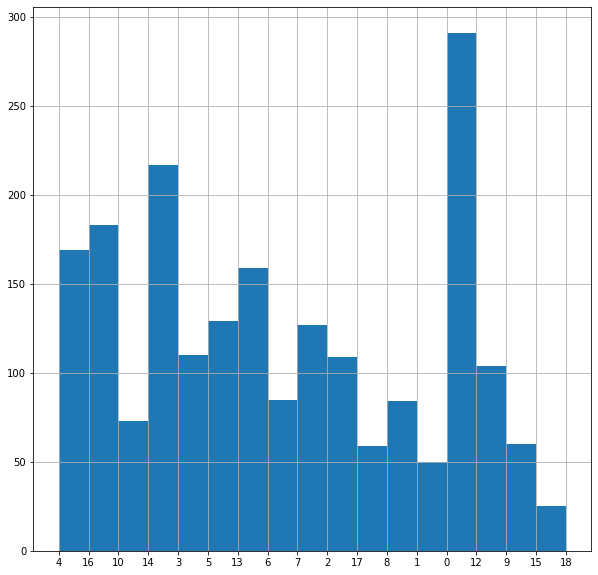

In [9]:
df_val[df_val['nr_of_labels'] == 1]['label'].hist(bins=17)

In [10]:
df_train[df_train['nr_of_labels'] == 1].head()

,id,blue,green,red,yellow,label,nr_of_labels
14279,a8b3fcb2-bbc6-11e8-b2bc-ac1f6b6435d0,a8b3fcb2-bbc6-11e8-b2bc-ac1f6b6435d0_blue.png,a8b3fcb2-bbc6-11e8-b2bc-ac1f6b6435d0_green.png,a8b3fcb2-bbc6-11e8-b2bc-ac1f6b6435d0_red.png,a8b3fcb2-bbc6-11e8-b2bc-ac1f6b6435d0_yellow.png,5,1
19397,e3f3c2ce-bbbe-11e8-b2ba-ac1f6b6435d0,e3f3c2ce-bbbe-11e8-b2ba-ac1f6b6435d0_blue.png,e3f3c2ce-bbbe-11e8-b2ba-ac1f6b6435d0_green.png,e3f3c2ce-bbbe-11e8-b2ba-ac1f6b6435d0_red.png,e3f3c2ce-bbbe-11e8-b2ba-ac1f6b6435d0_yellow.png,4,1
4577,364be9d0-bbc3-11e8-b2bc-ac1f6b6435d0,364be9d0-bbc3-11e8-b2bc-ac1f6b6435d0_blue.png,364be9d0-bbc3-11e8-b2bc-ac1f6b6435d0_green.png,364be9d0-bbc3-11e8-b2bc-ac1f6b6435d0_red.png,364be9d0-bbc3-11e8-b2bc-ac1f6b6435d0_yellow.png,7,1
12730,96fb0a0a-bba4-11e8-b2b9-ac1f6b6435d0,96fb0a0a-bba4-11e8-b2b9-ac1f6b6435d0_blue.png,96fb0a0a-bba4-11e8-b2b9-ac1f6b6435d0_green.png,96fb0a0a-bba4-11e8-b2b9-ac1f6b6435d0_red.png,96fb0a0a-bba4-11e8-b2b9-ac1f6b6435d0_yellow.png,4,1
20943,f5cbc37e-bb9c-11e8-b2b9-ac1f6b6435d0,f5cbc37e-bb9c-11e8-b2b9-ac1f6b6435d0_blue.png,f5cbc37e-bb9c-11e8-b2b9-ac1f6b6435d0_green.png,f5cbc37e-bb9c-11e8-b2b9-ac1f6b6435d0_red.png,f5cbc37e-bb9c-11e8-b2b9-ac1f6b6435d0_yellow.png,3,1


In [11]:
df_train[df_train['nr_of_labels'] == 1]['label'].unique().size

19

In [12]:
df_files.shape

(21806, 7)

In [13]:
def plot_cells(_id='5006bf20-bba1-11e8-b2b9-ac1f6b6435d0', label=-1):
    d = read_img(_id=_id)
    args = {"cmap":'gray', "vmin":0, "vmax":255}
    f, axarr = plt.subplots(2,2, figsize=(20, 20))
    f.suptitle(label)
    ax = axarr[0,0]; ax.imshow(d['blue'], **args); ax.set_title('Blue')
    ax = axarr[0,1]; ax.imshow(d['green'], **args); ax.set_title('Green')
    ax = axarr[1,0]; ax.imshow(d['red'], **args); ax.set_title('Red')
    ax = axarr[1,1]; ax.imshow(d['yellow'], **args); ax.set_title('Yellow')
    plt.show()
    stacked_images = np.transpose(np.array([d['red'], d['green'], d['blue']]), (1,2,0))
    plt.figure(figsize = (20,20))
    plt.imshow(stacked_images)
    plt.show()

21326f30-bbb2-11e8-b2ba-ac1f6b6435d0


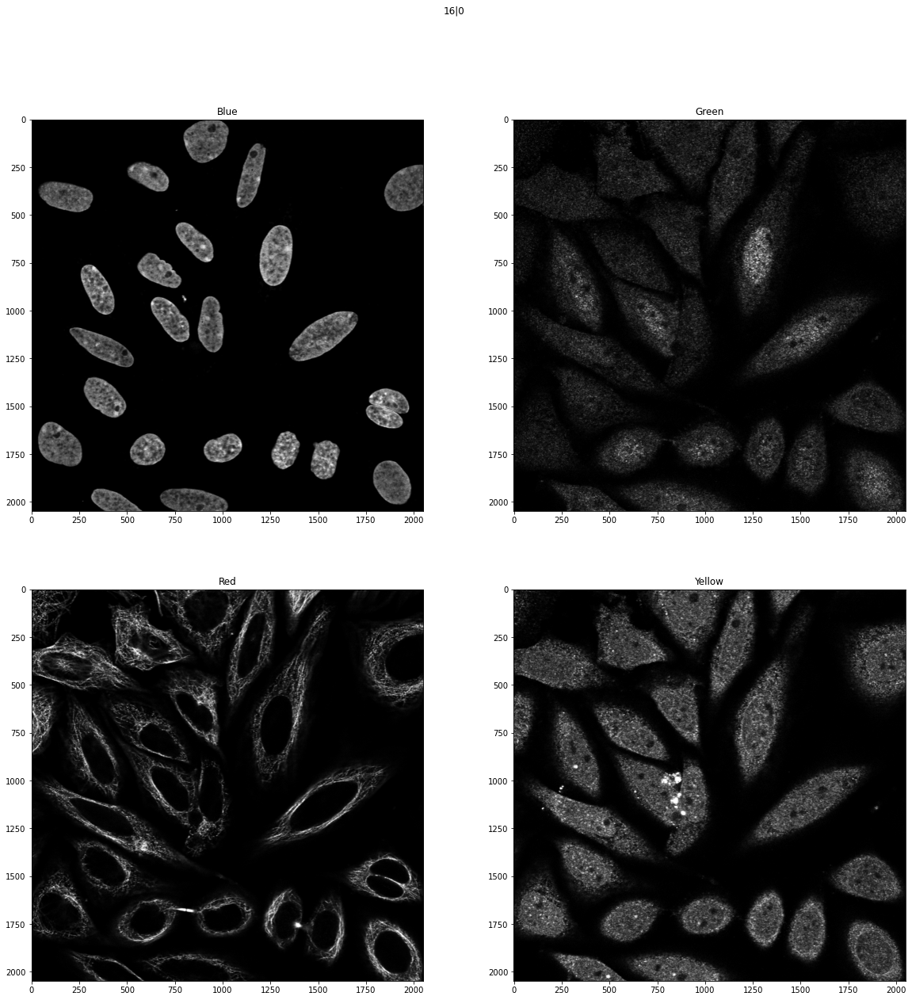

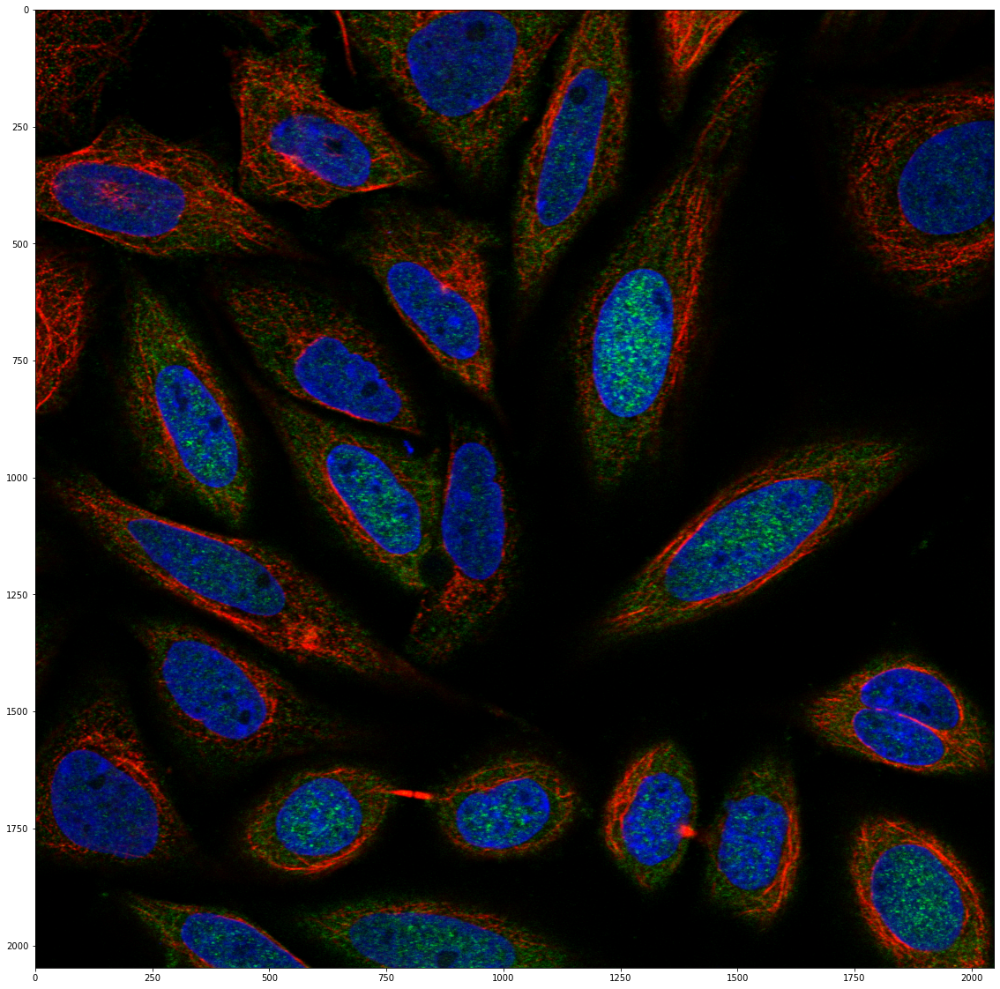

9c7d066a-bbb6-11e8-b2ba-ac1f6b6435d0


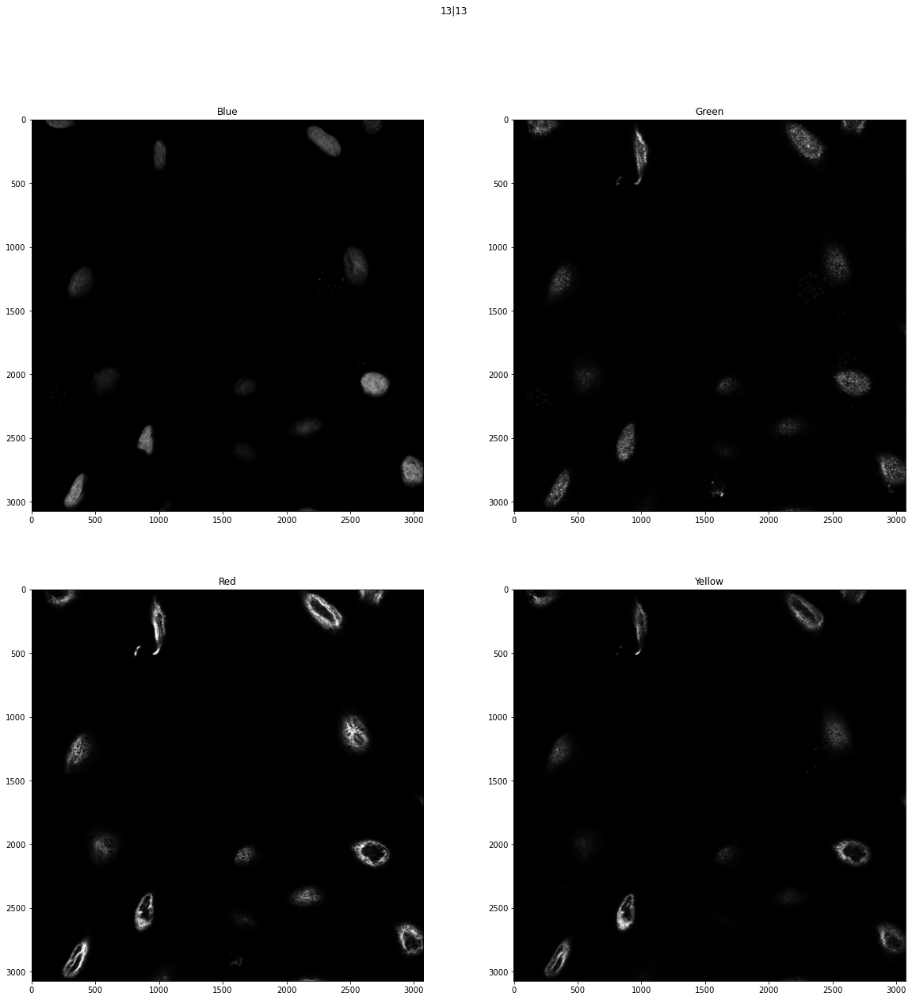

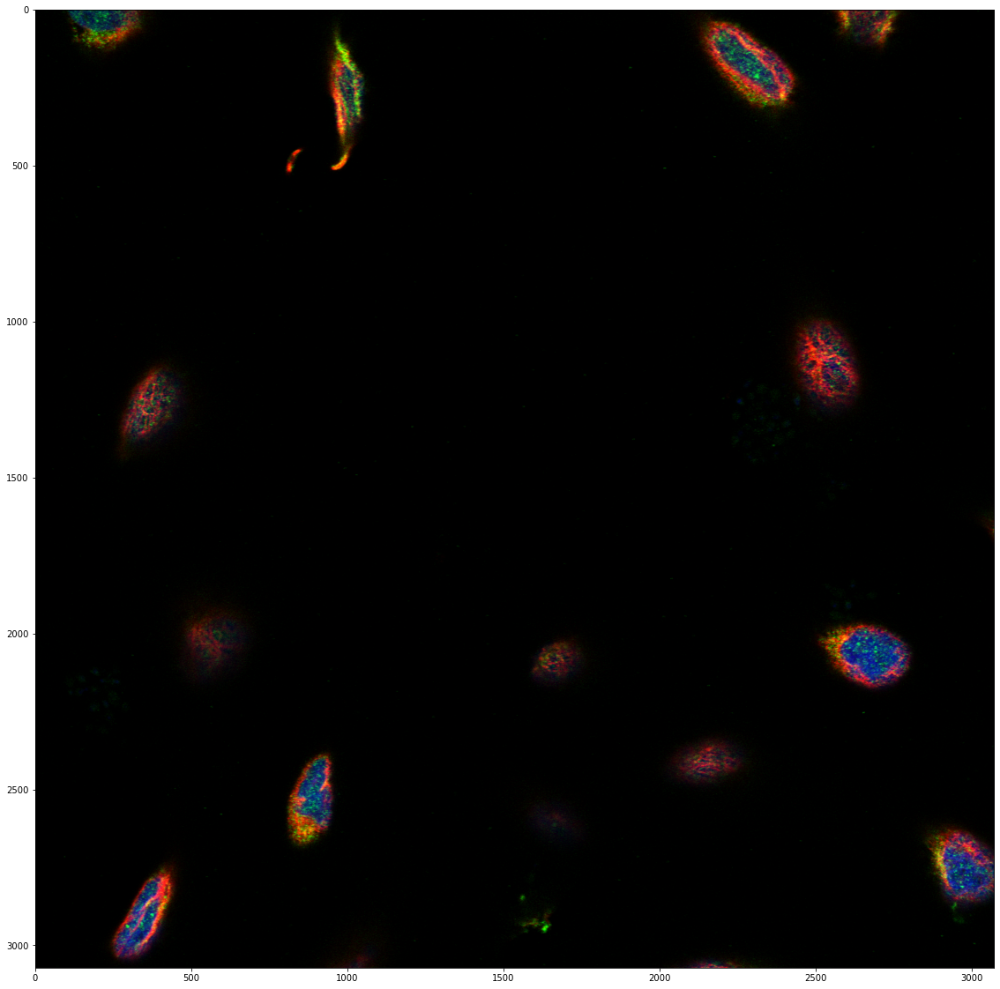

4a4dabf8-bbb4-11e8-b2ba-ac1f6b6435d0


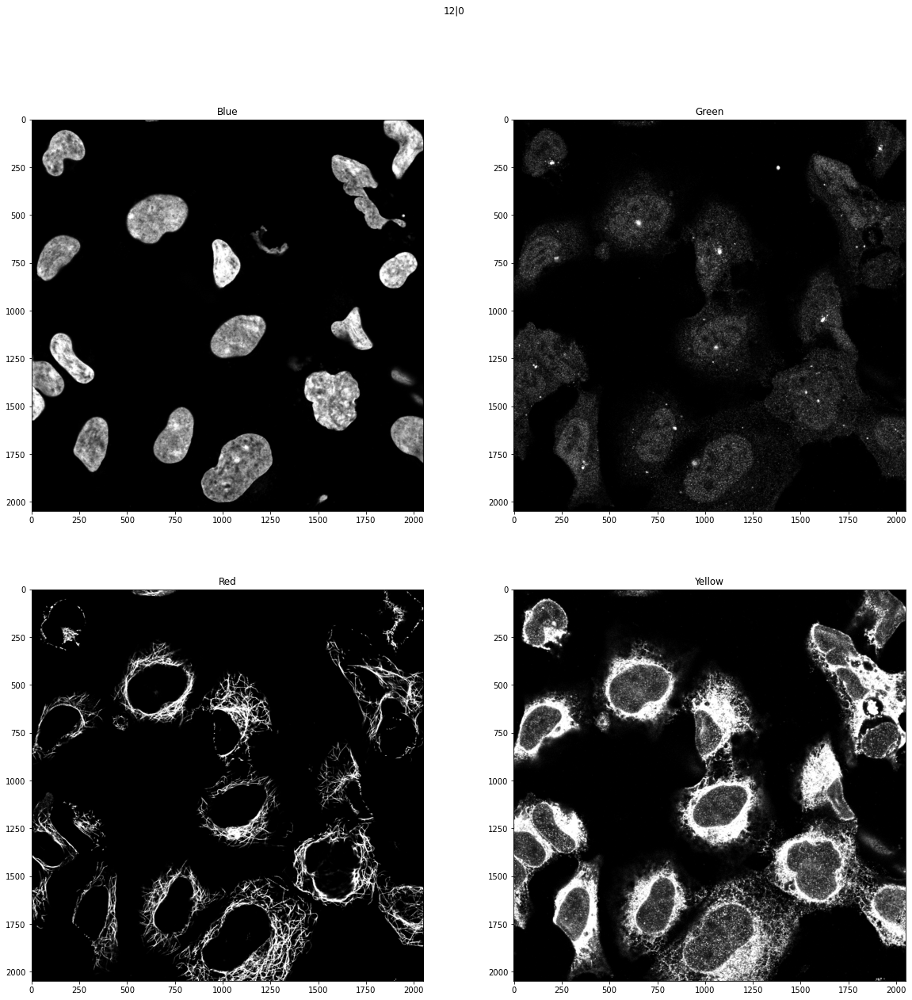

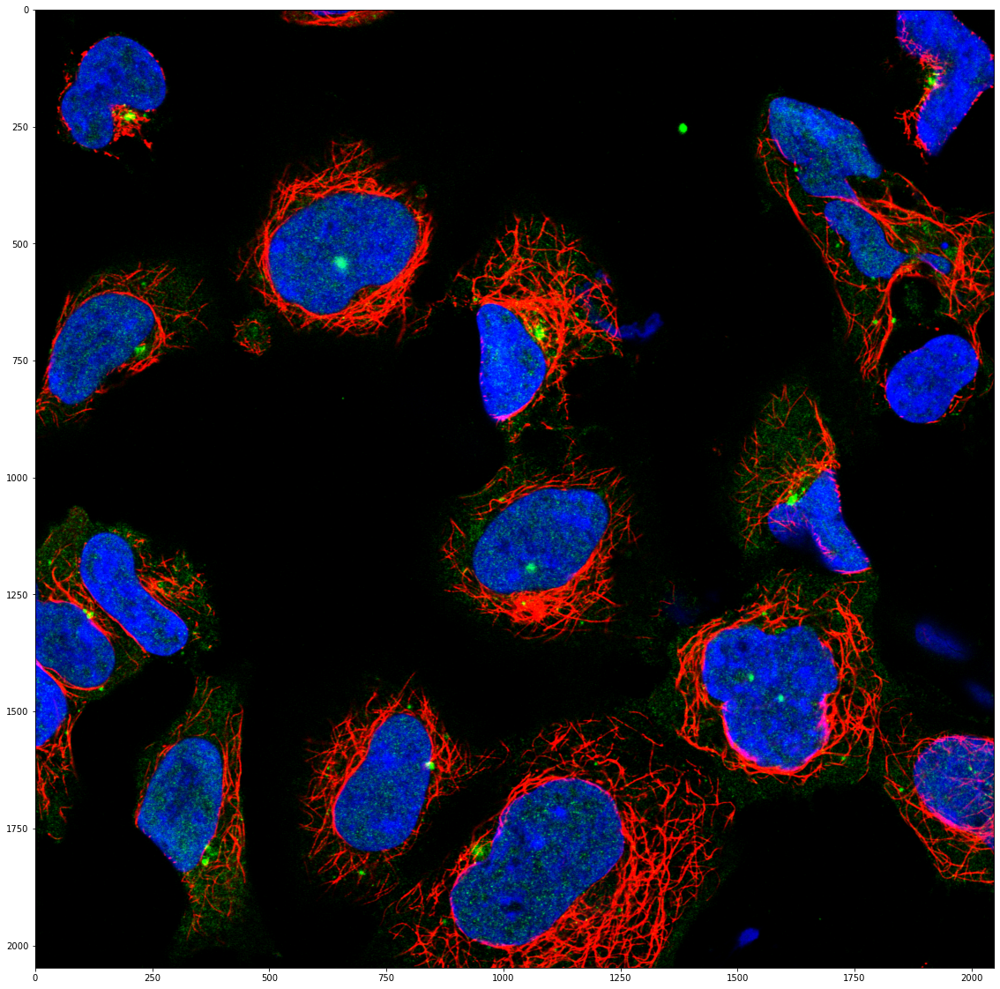

ec5ea784-bba1-11e8-b2b9-ac1f6b6435d0


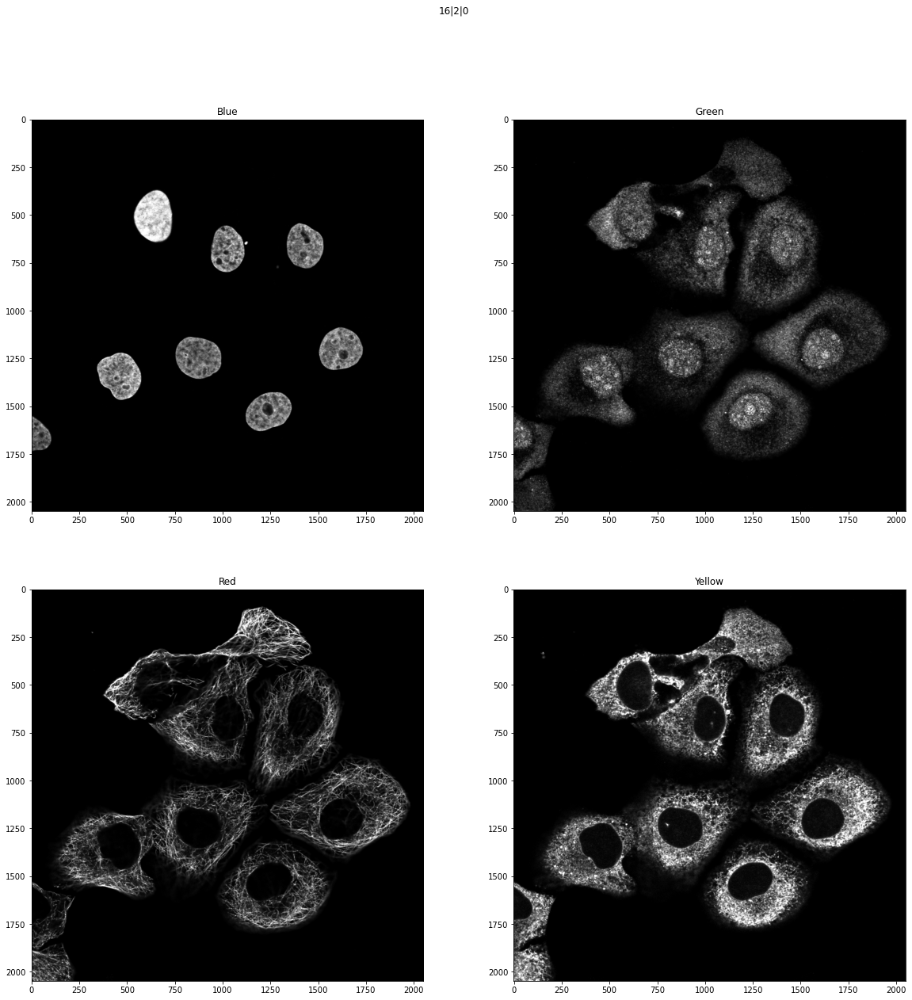

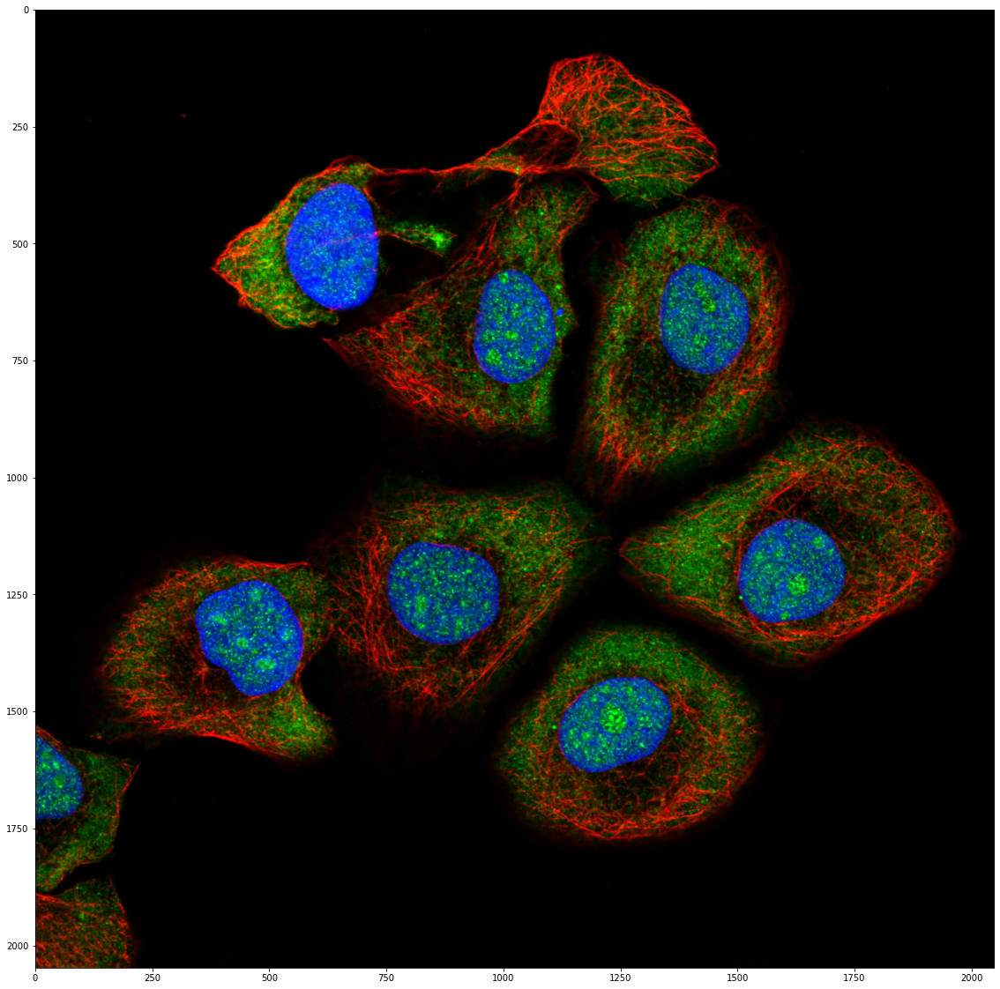

In [14]:
i = 0
for idx, row in df_train[df_train['nr_of_labels'] > 1].iterrows():
    print(row['id'])
    plot_cells(row['id'], row['label'])
    i = i + 1
    if i > 3:
        break

9bf5fdd4-bbaa-11e8-b2ba-ac1f6b6435d0


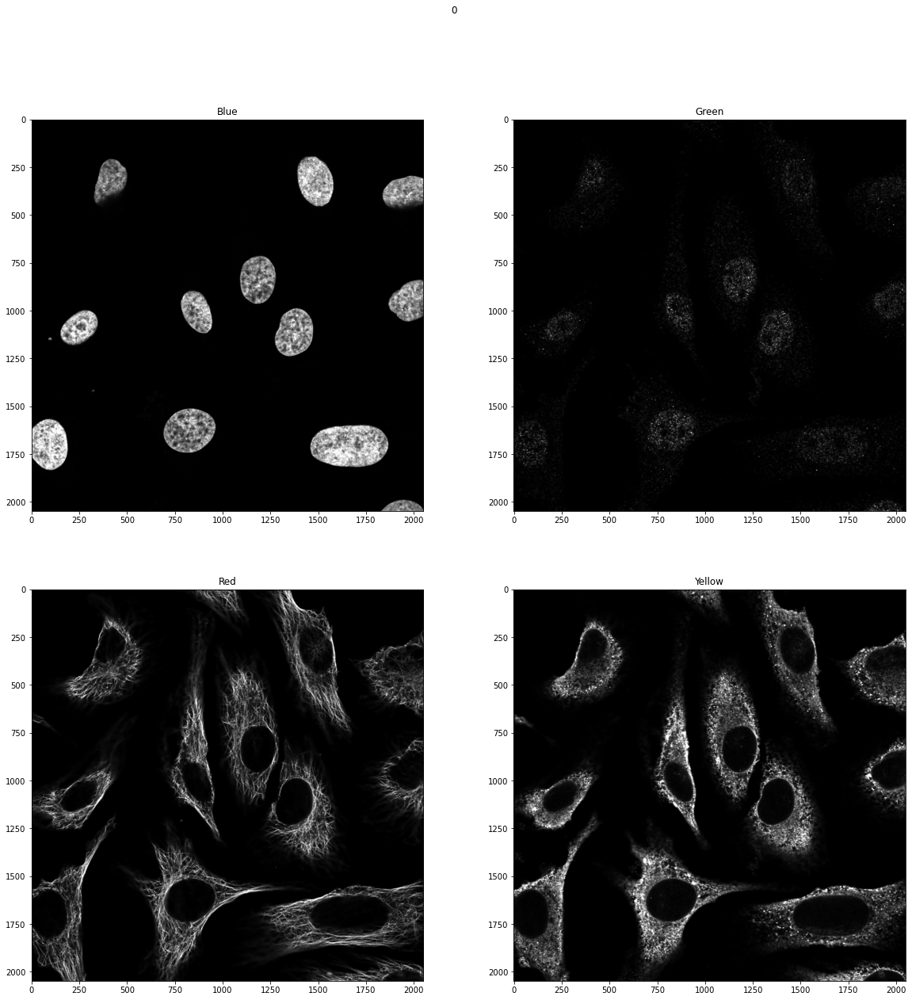

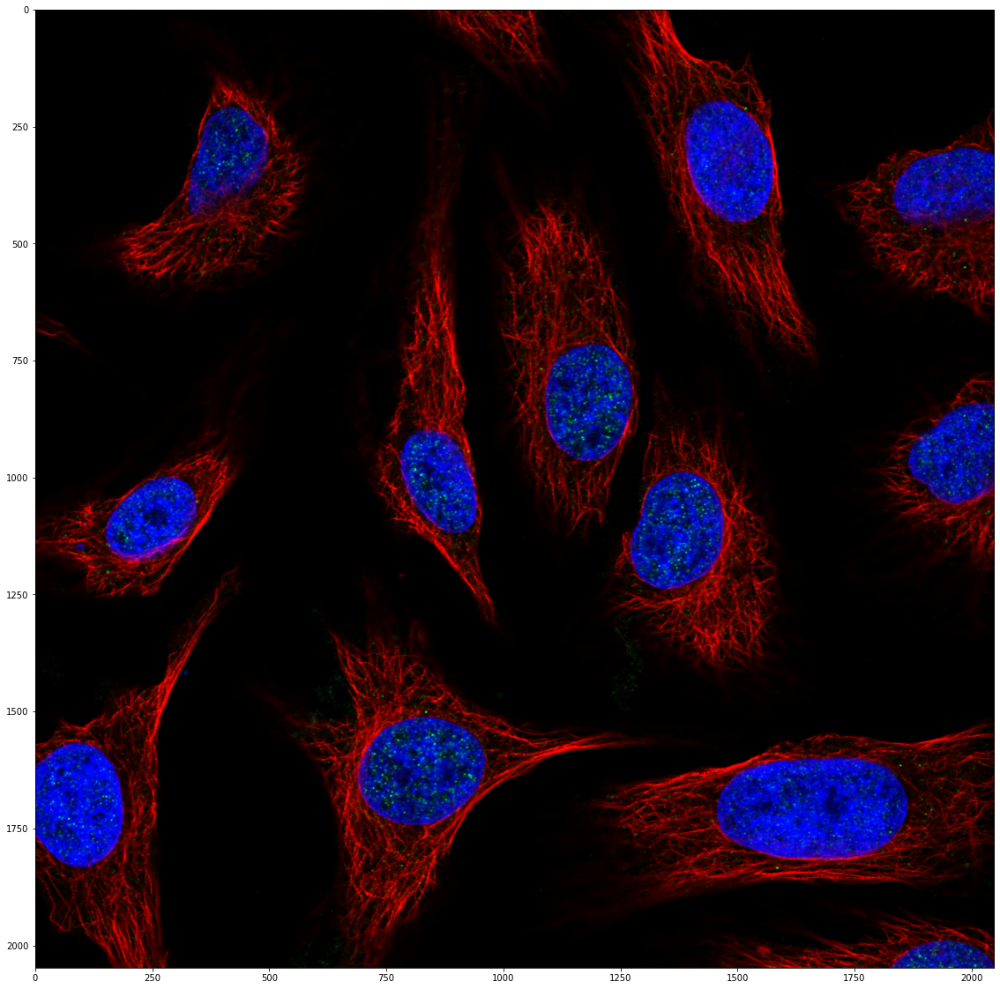

209222fe-bbb3-11e8-b2ba-ac1f6b6435d0


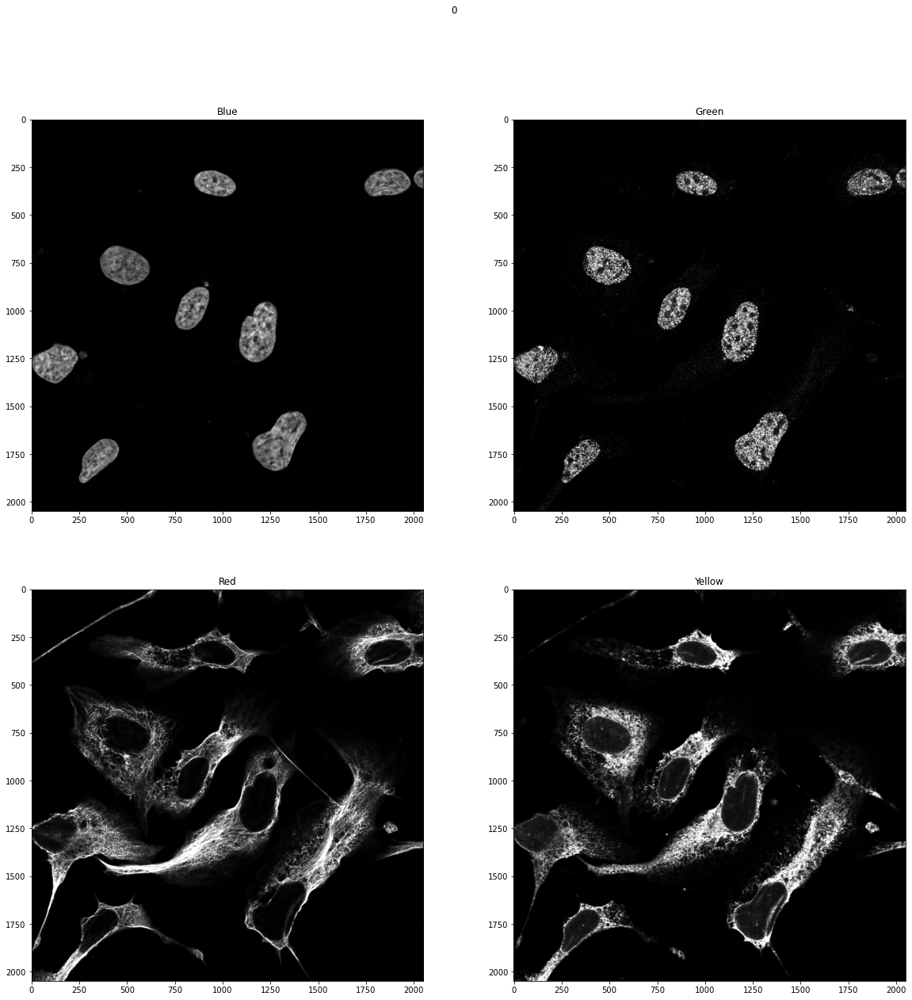

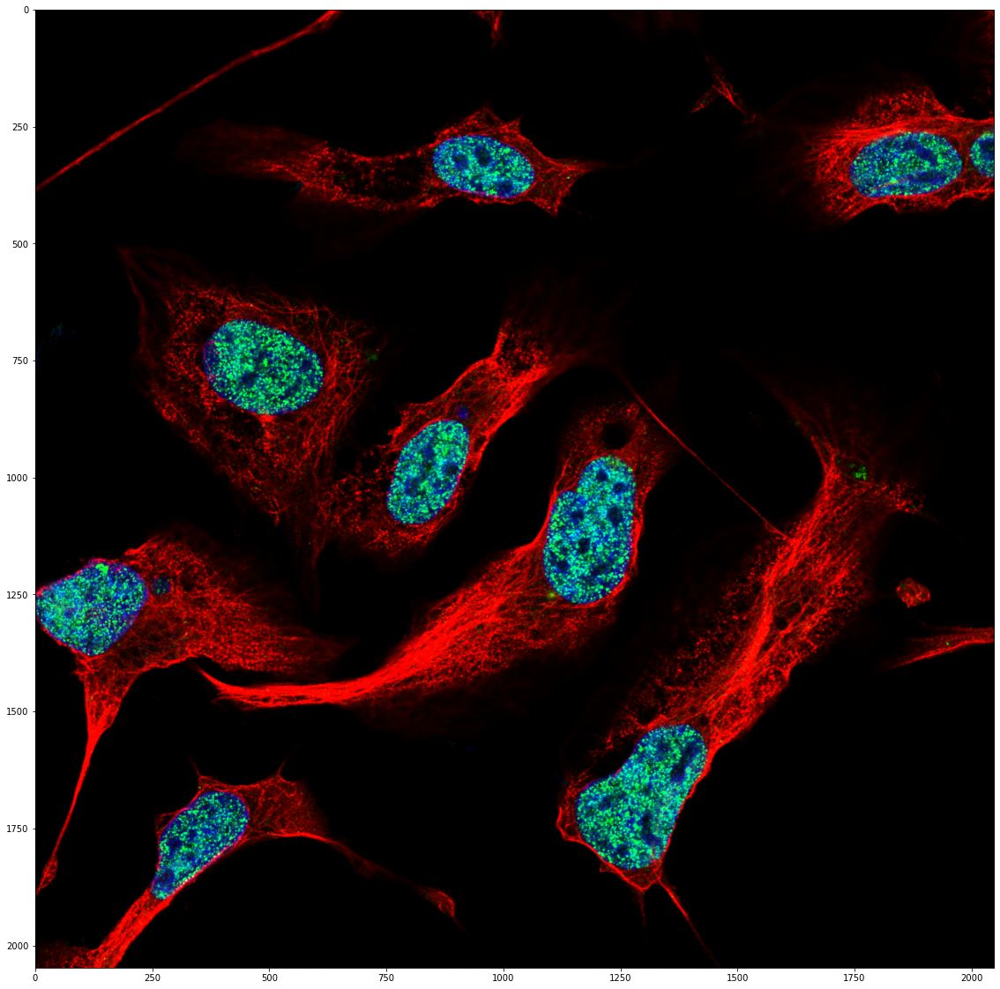

7133454c-bba1-11e8-b2b9-ac1f6b6435d0


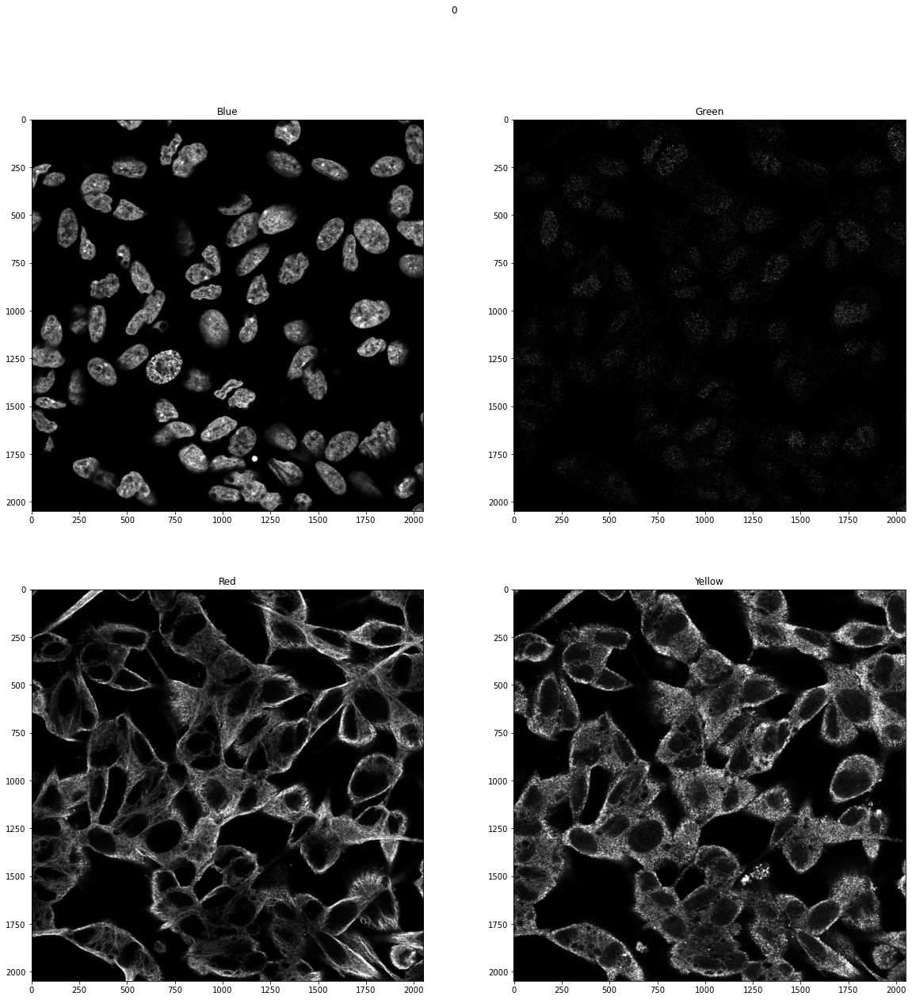

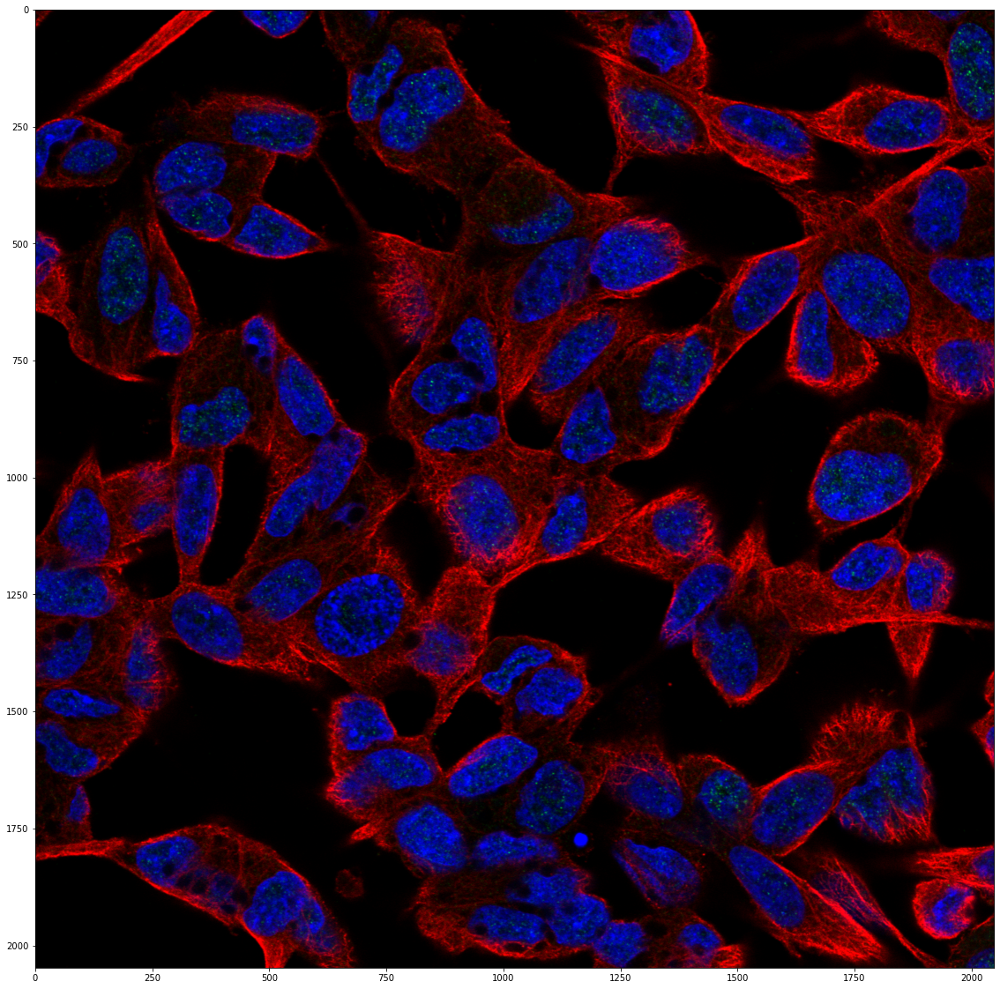

dd96db5c-bbb2-11e8-b2ba-ac1f6b6435d0


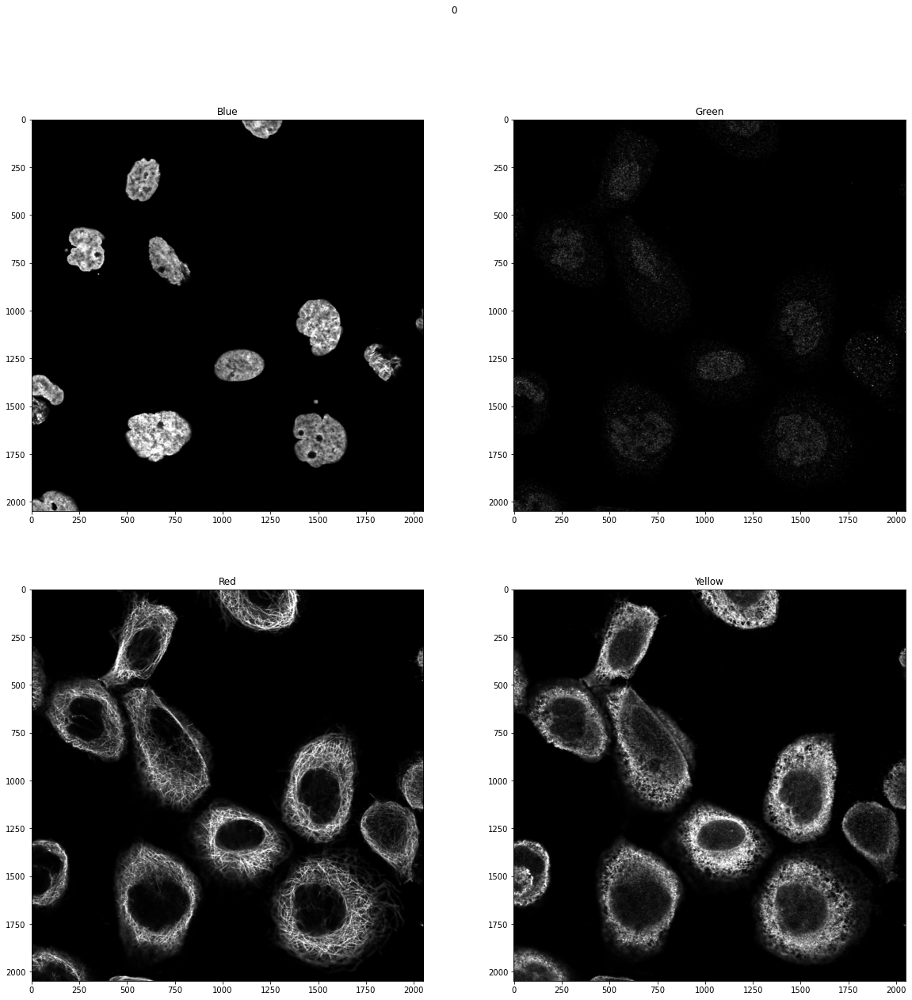

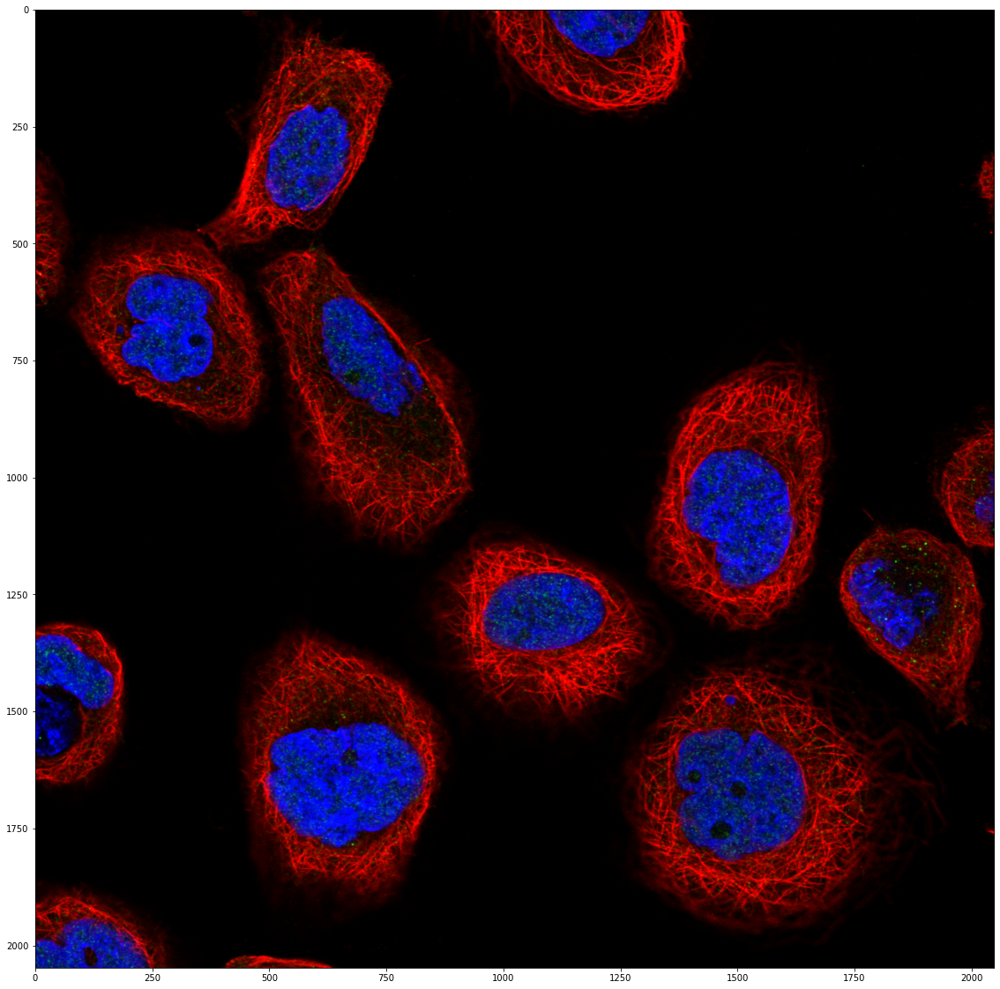

In [15]:
i = 0
for idx, row in df_train[df_train['label'] == '0'].iterrows():
    print(row['id'])
    plot_cells(row['id'], row['label'])
    i = i + 1
    if i > 3:
        break

97866db0-bbc3-11e8-b2bc-ac1f6b6435d0


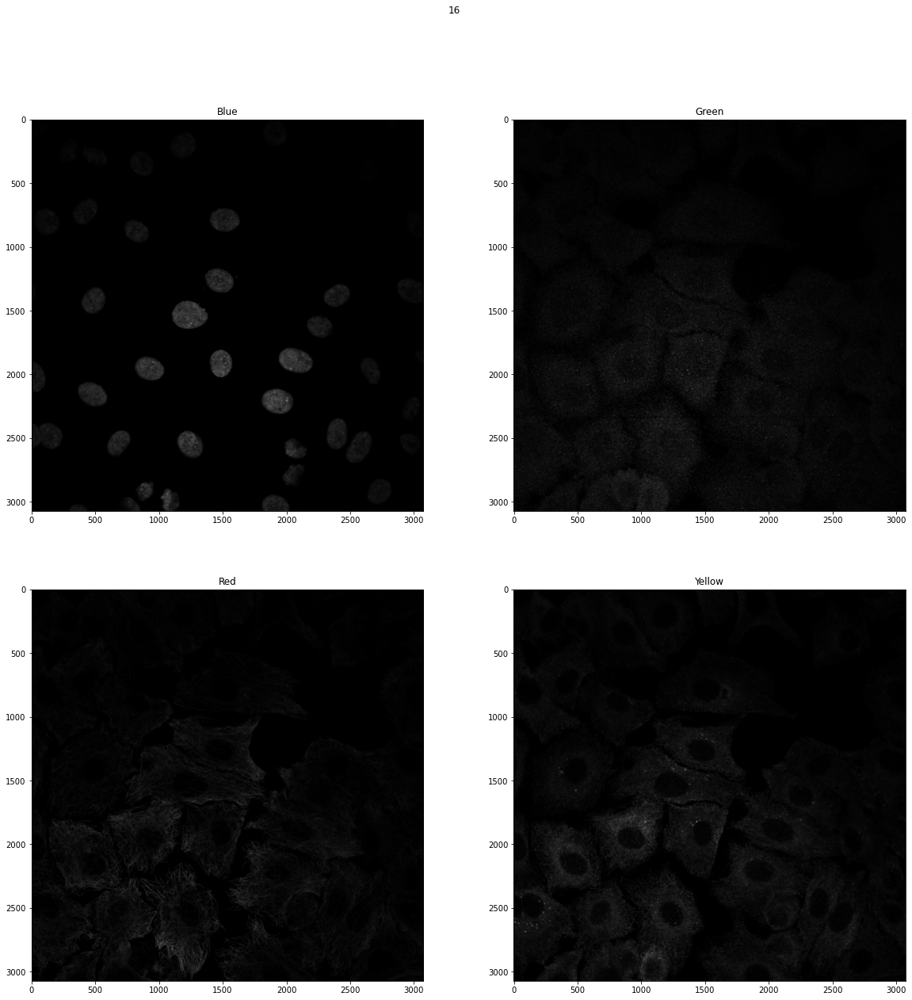

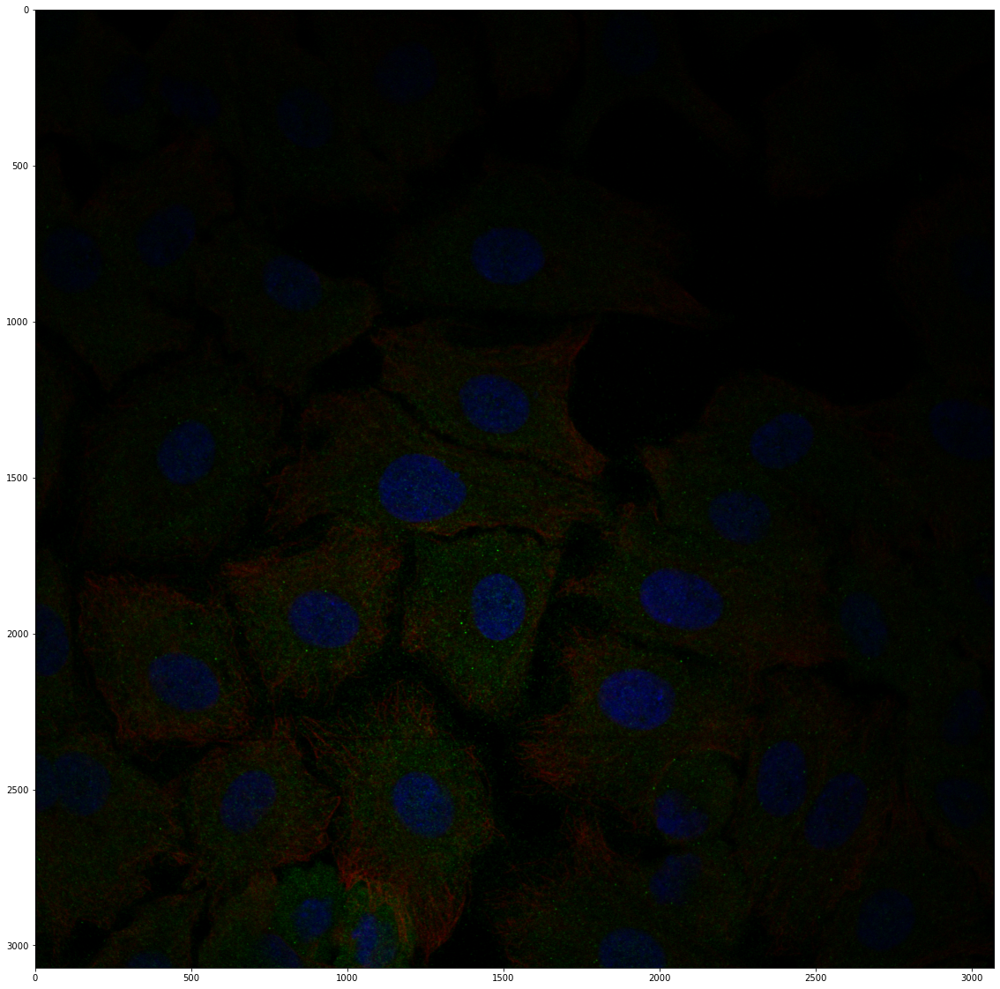

8285218a-bbbf-11e8-b2bb-ac1f6b6435d0


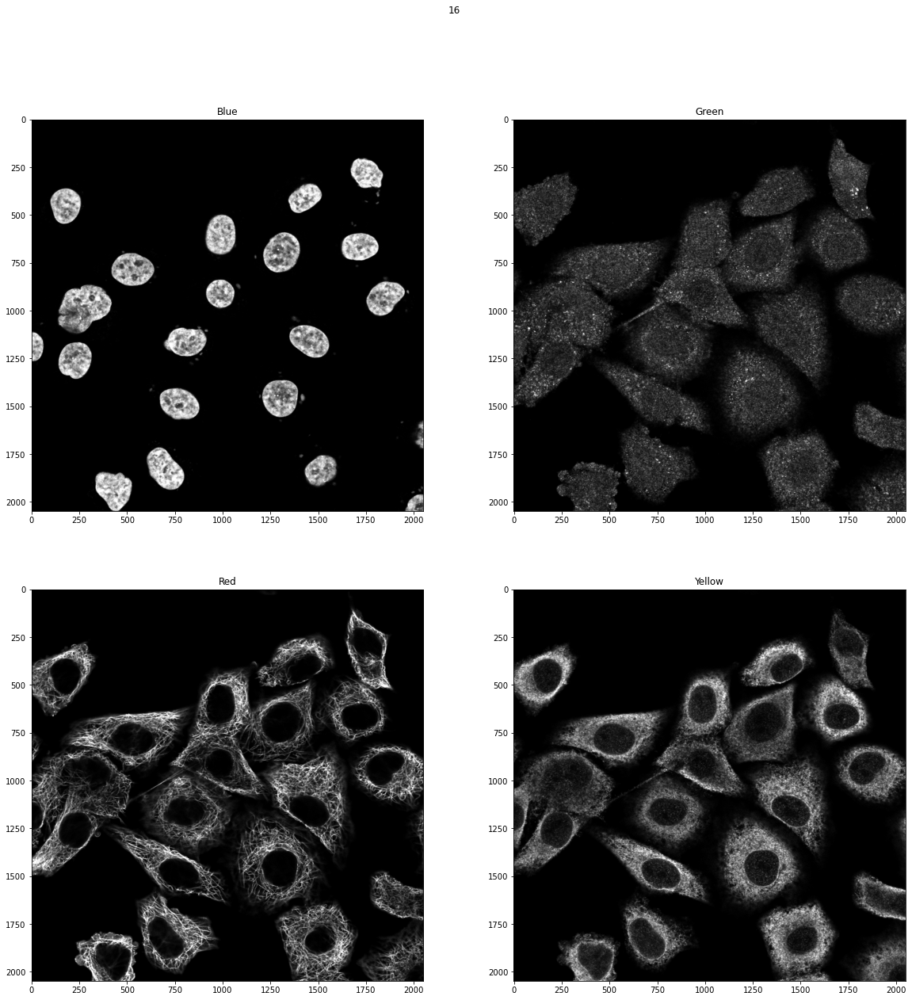

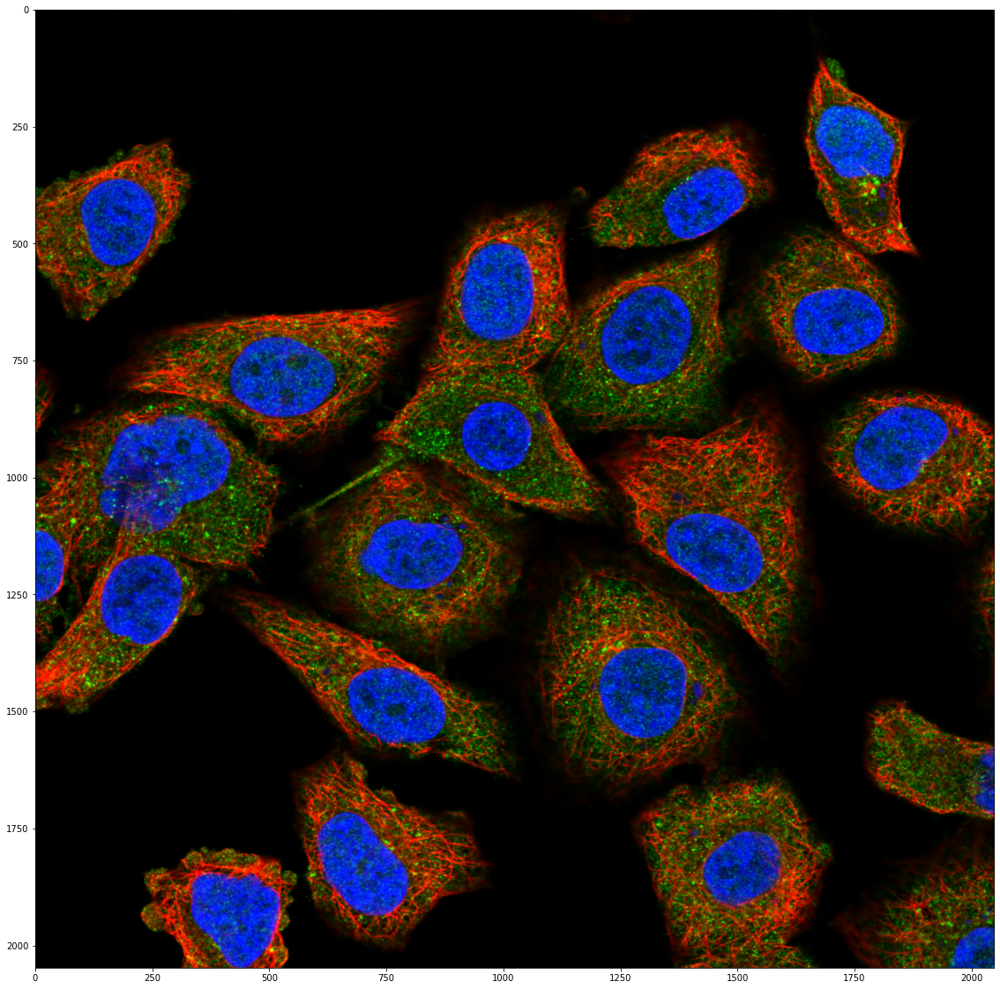

abe442e2-bbae-11e8-b2ba-ac1f6b6435d0


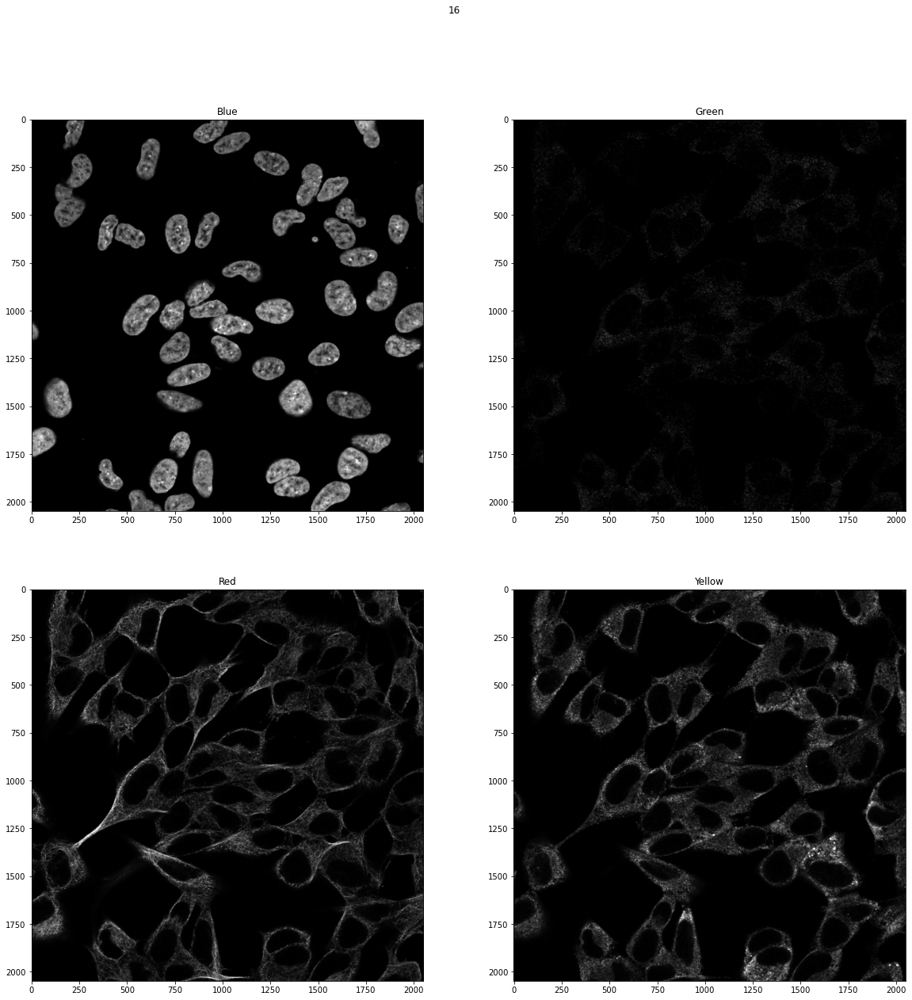

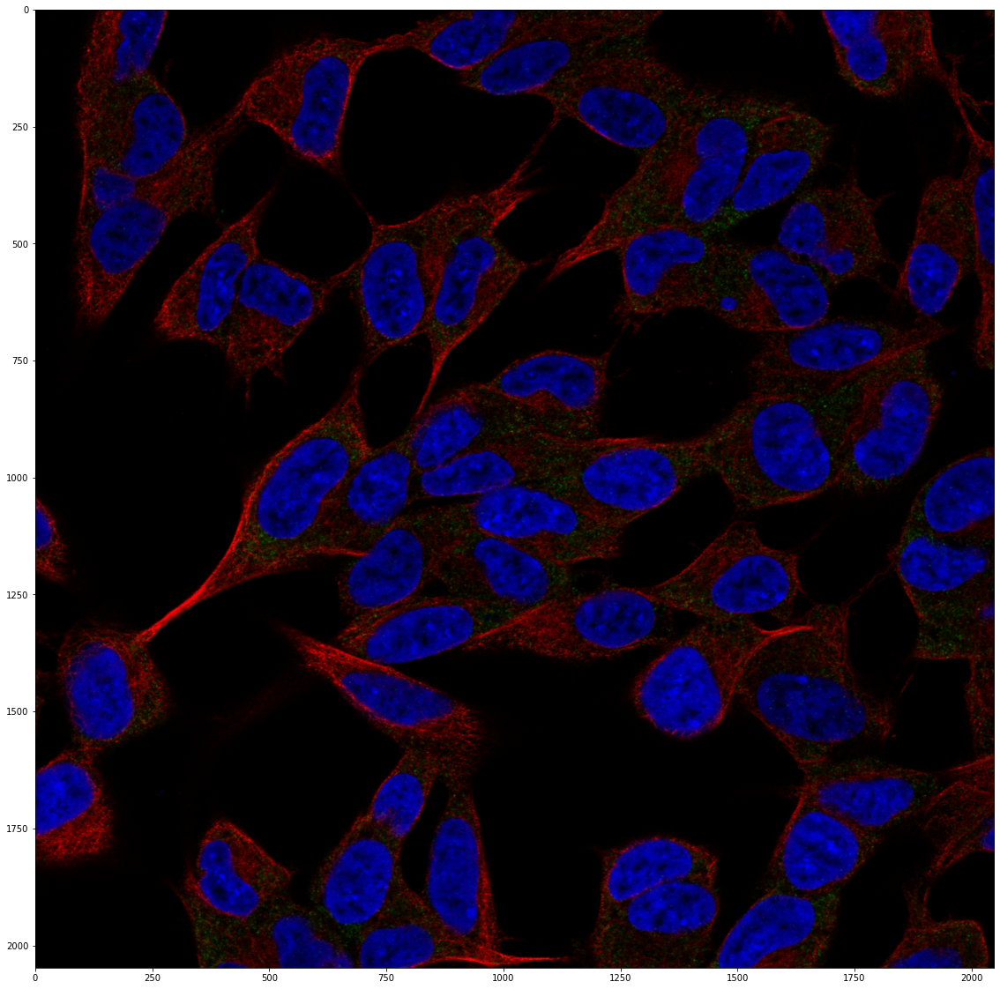

4b8edfd2-bb9b-11e8-b2b9-ac1f6b6435d0


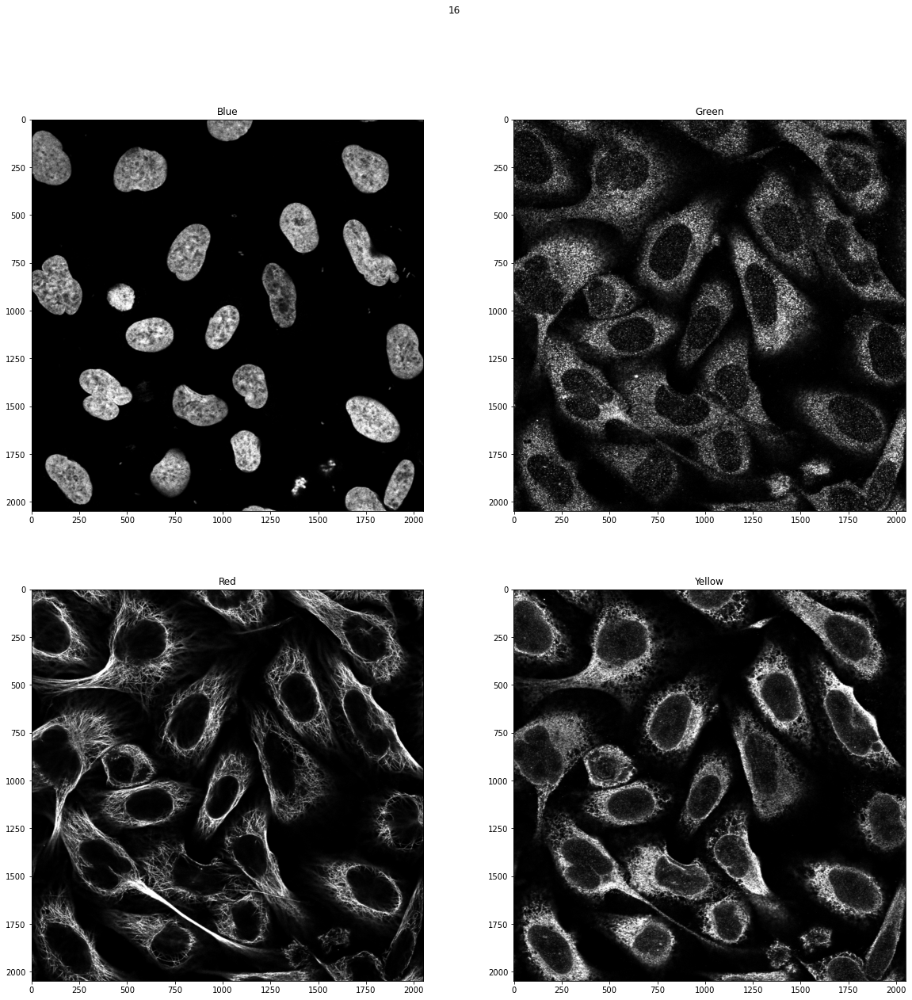

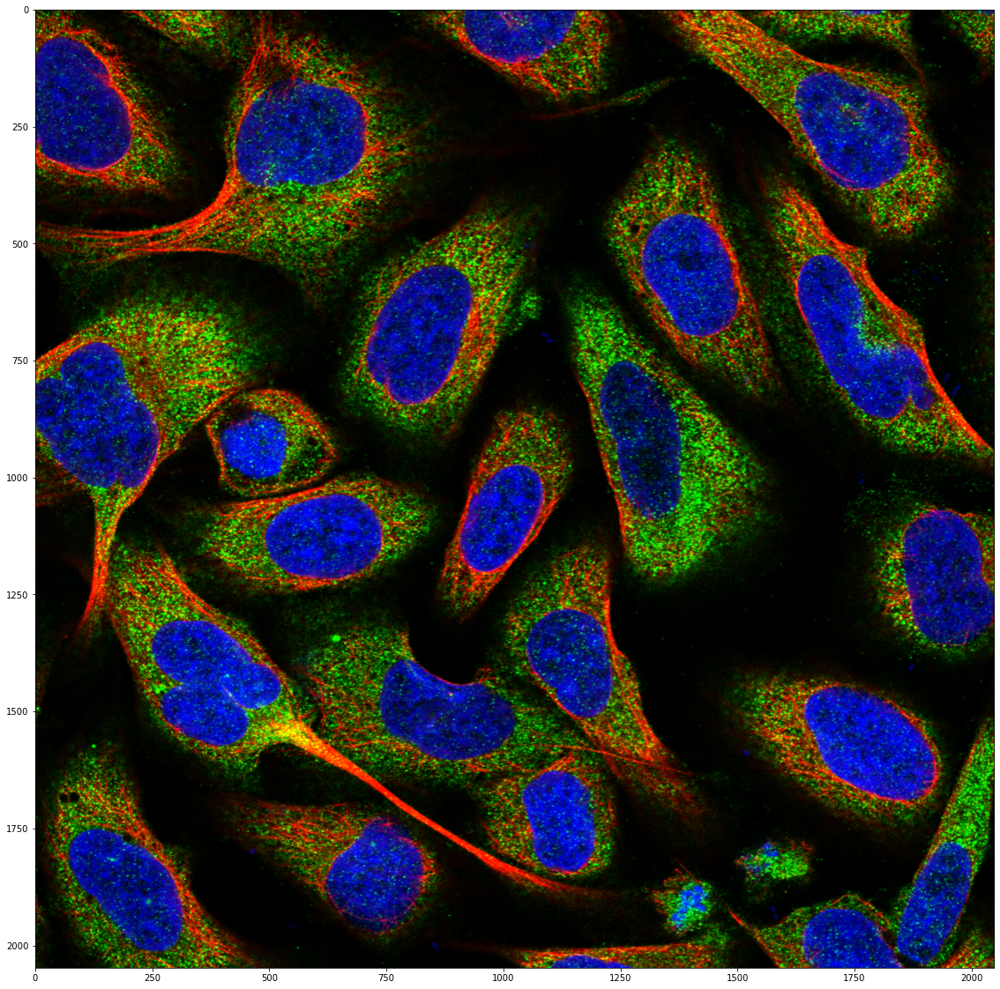

In [16]:
i = 0
for idx, row in df_train[df_train['label'] == '16'].iterrows():
    print(row['id'])
    plot_cells(row['id'], row['label'])
    i = i + 1
    if i > 3:
        break

a8b3fcb2-bbc6-11e8-b2bc-ac1f6b6435d0


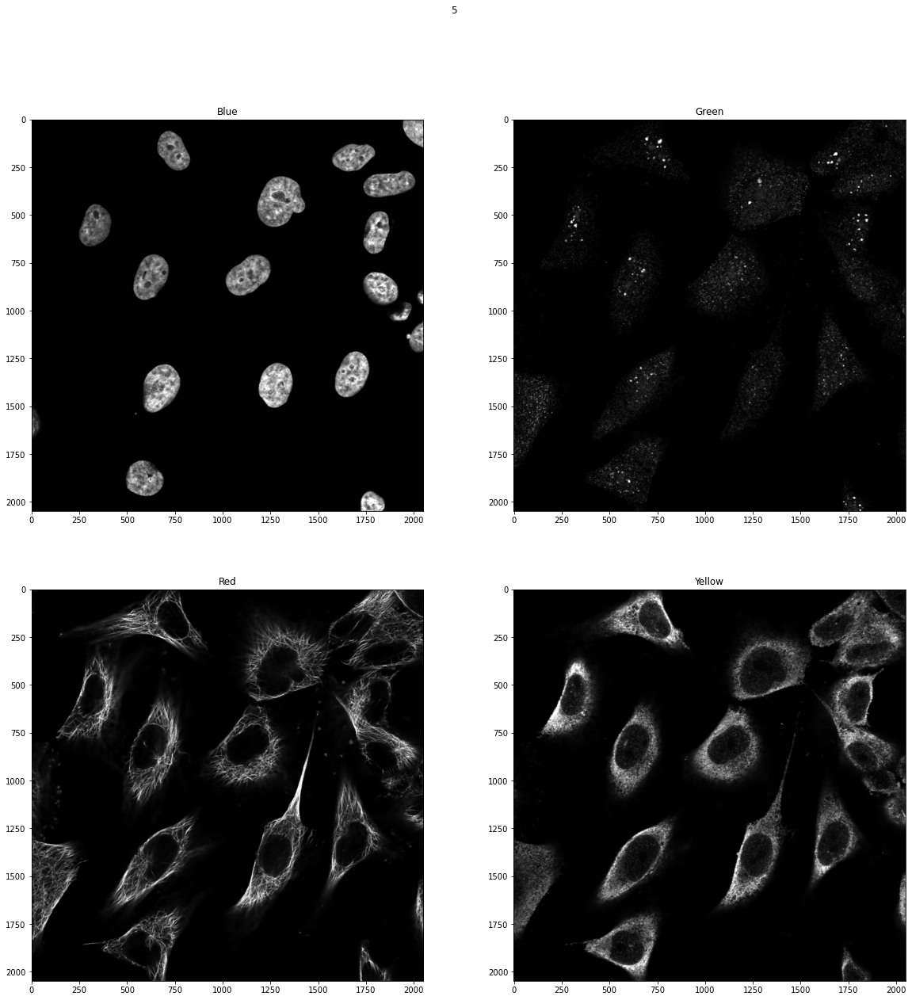

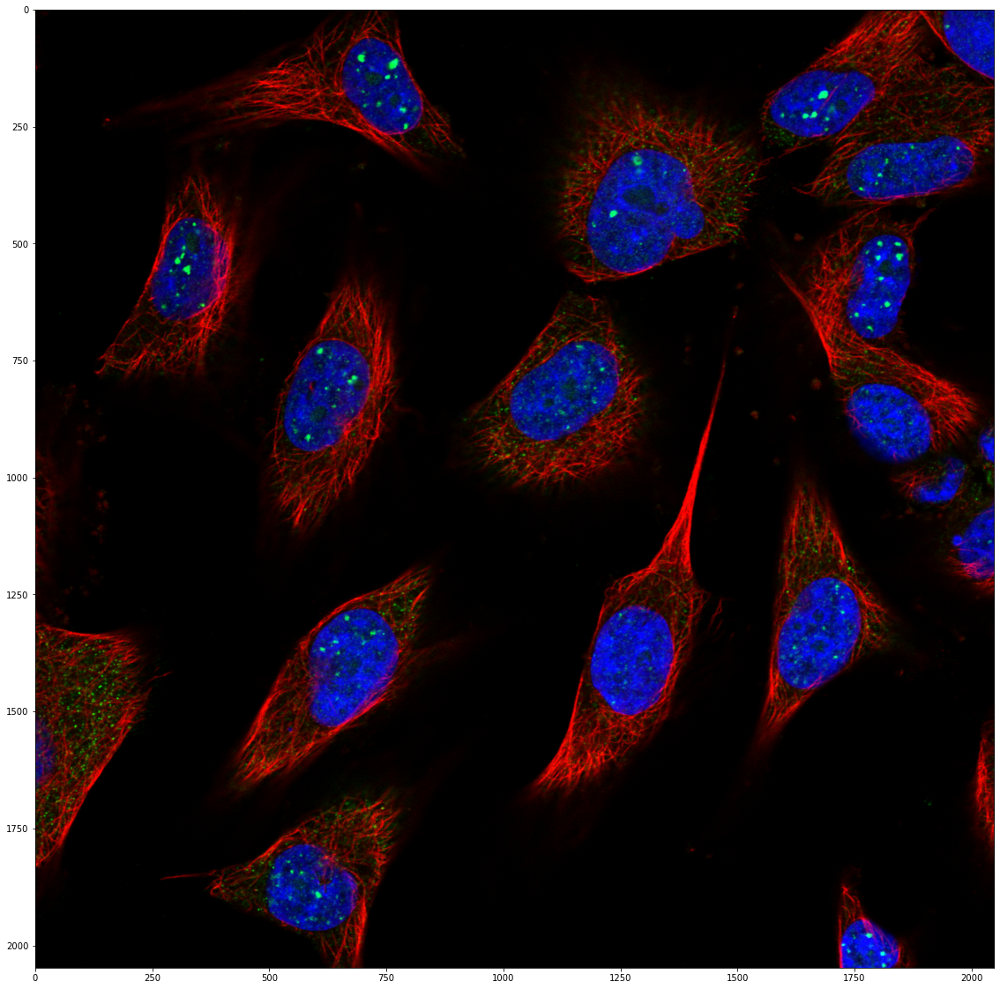

e3f3c2ce-bbbe-11e8-b2ba-ac1f6b6435d0


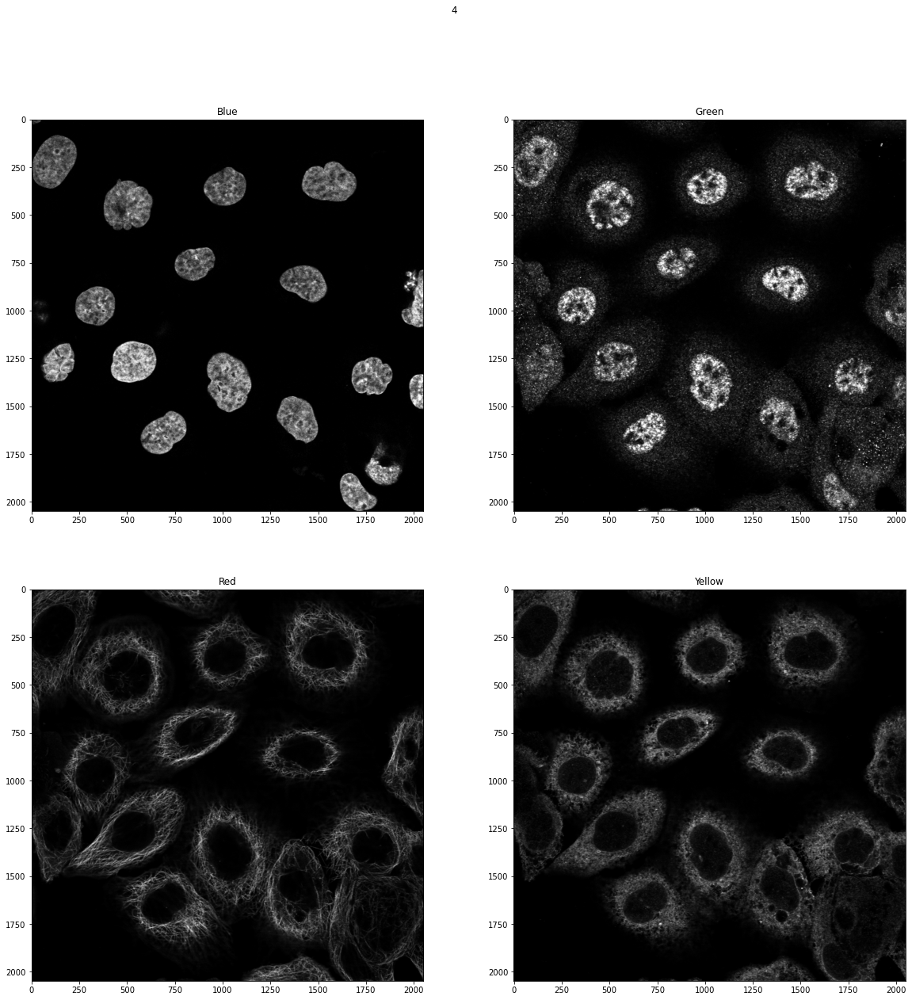

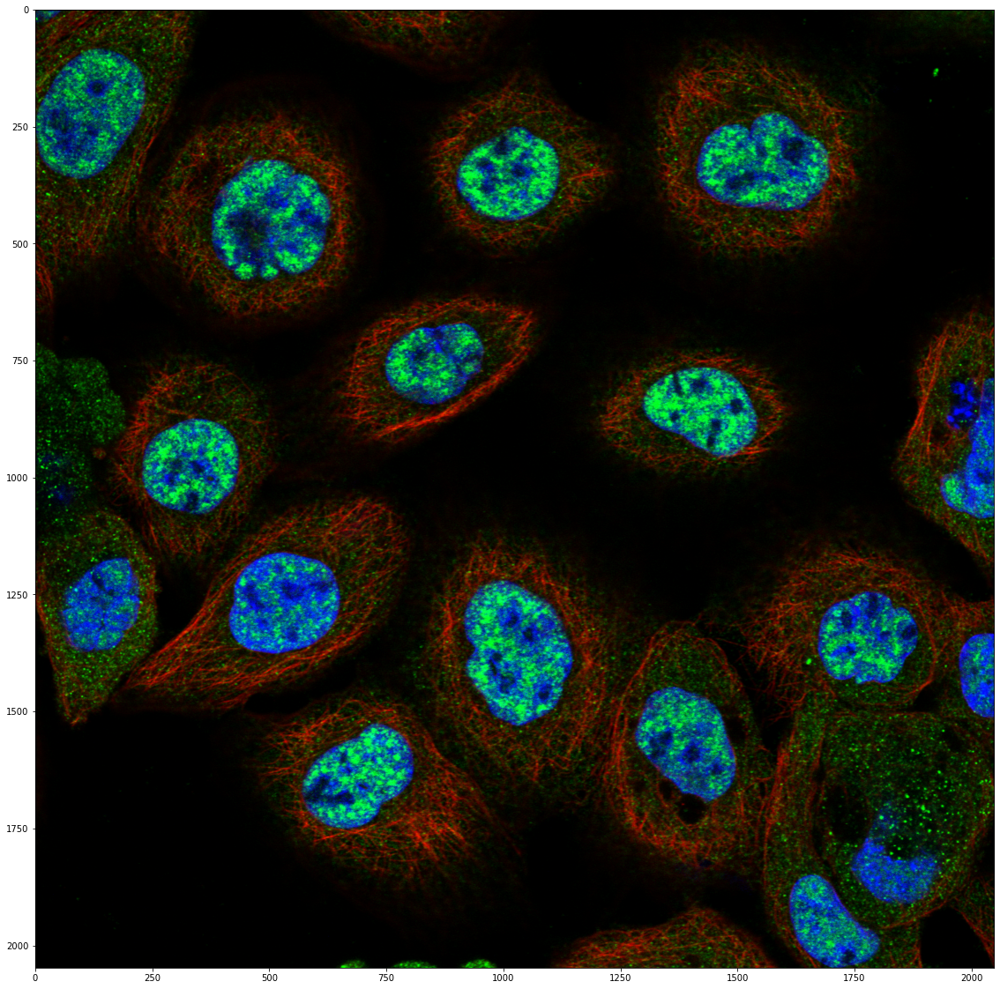

364be9d0-bbc3-11e8-b2bc-ac1f6b6435d0


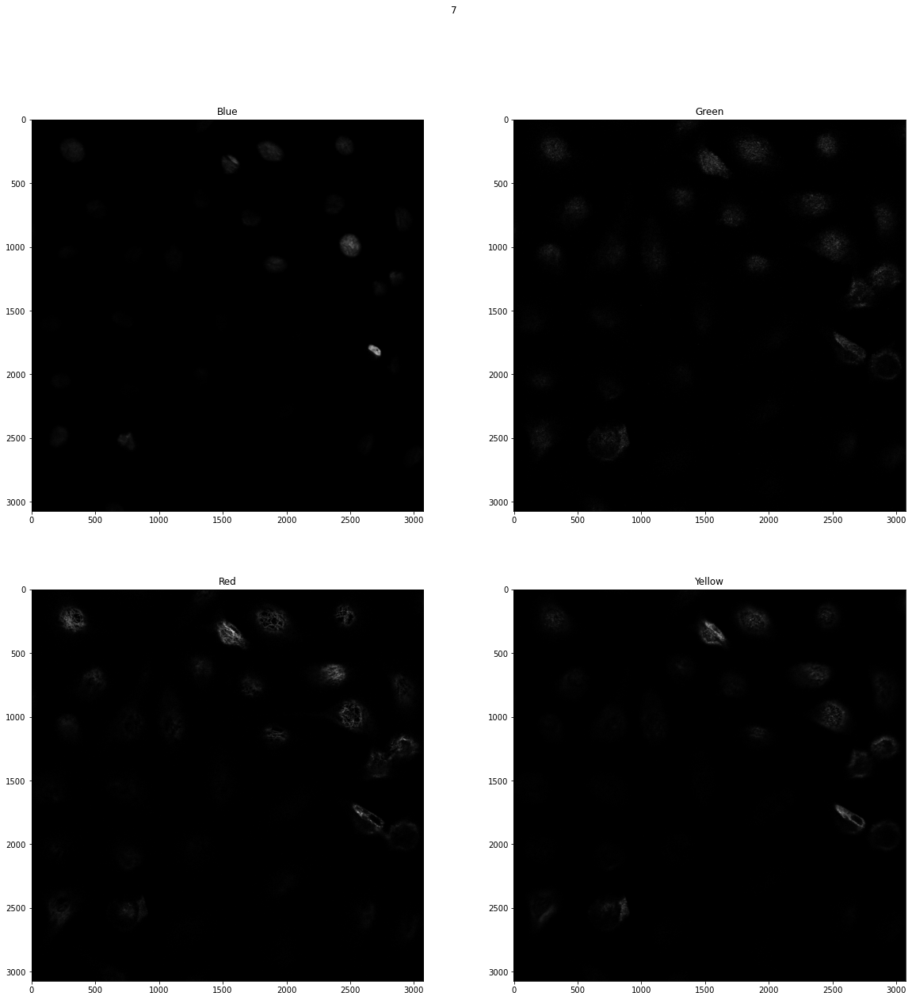

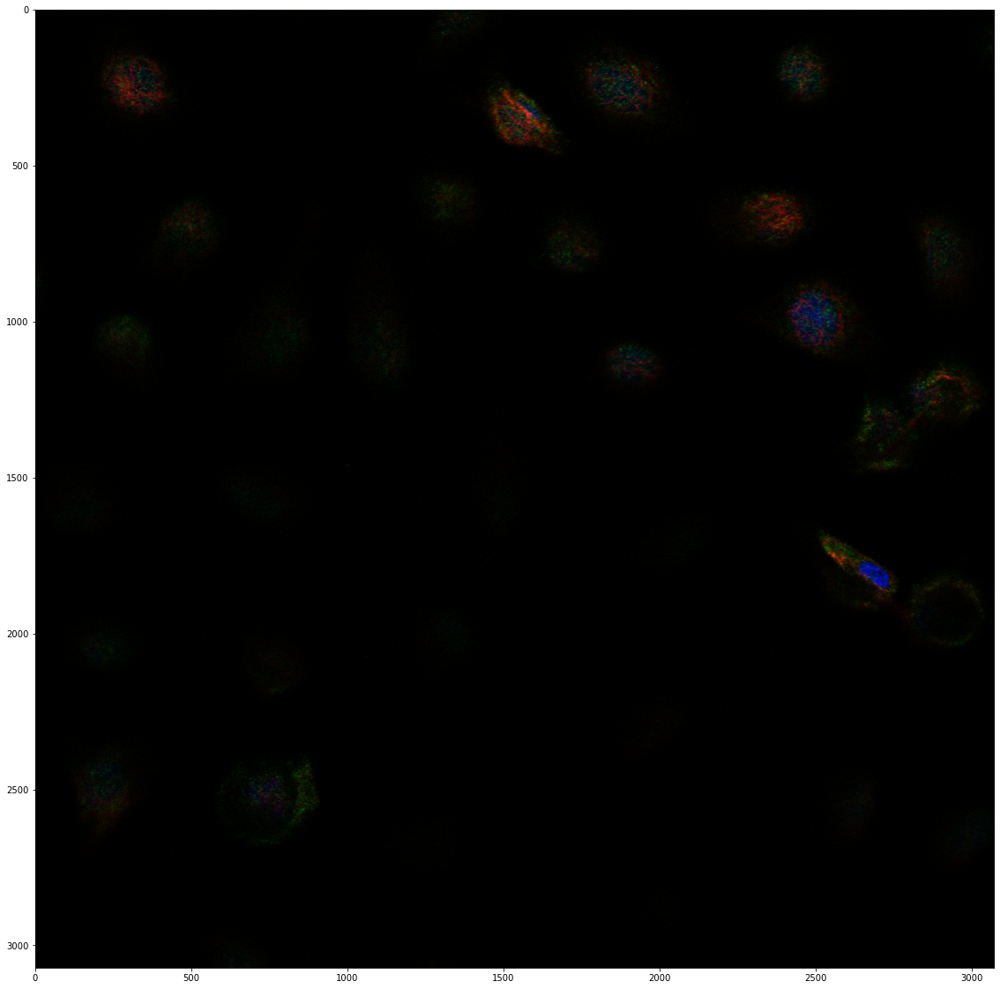

96fb0a0a-bba4-11e8-b2b9-ac1f6b6435d0


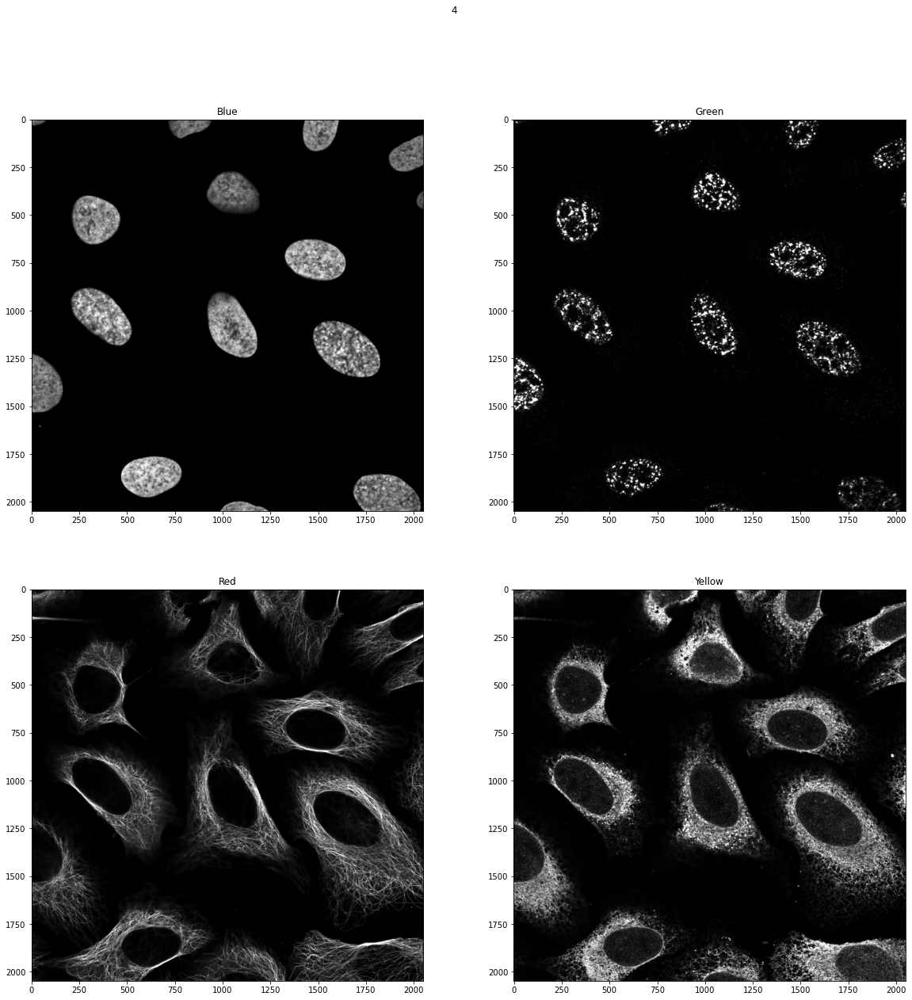

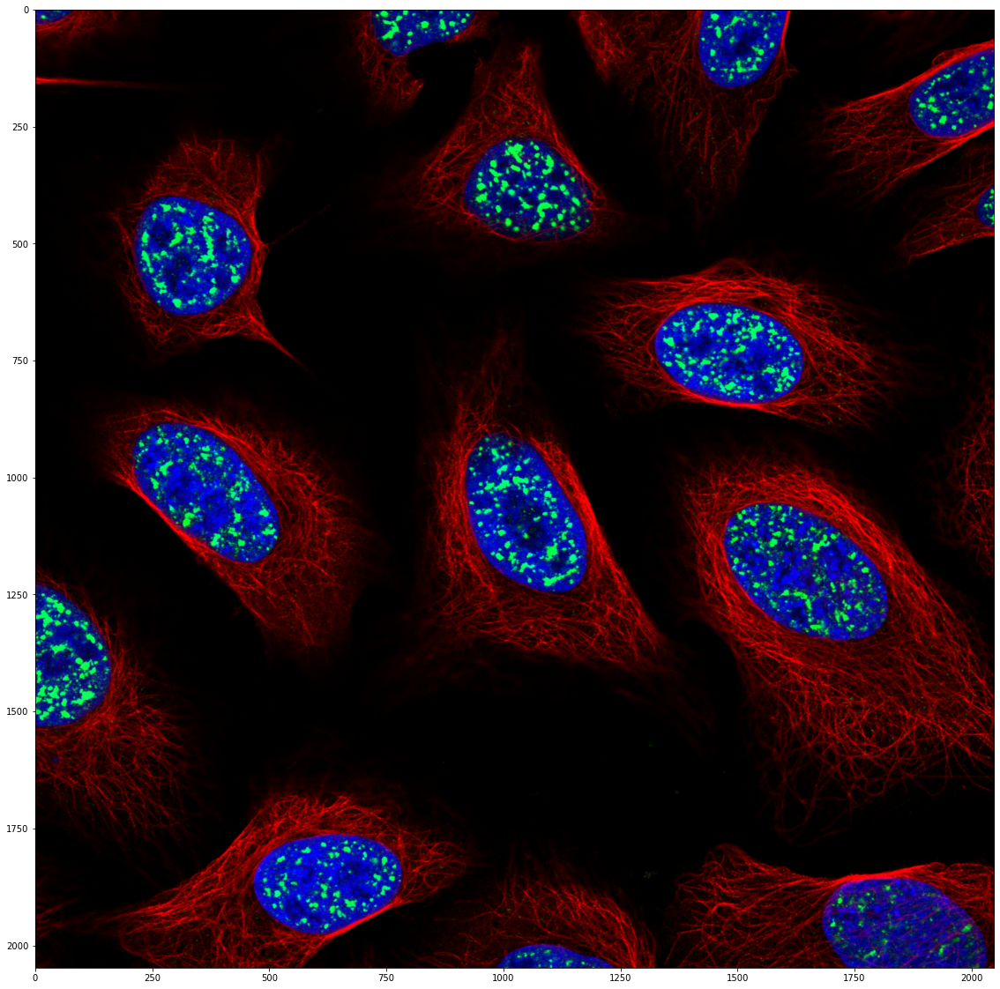

In [17]:
i = 0
for idx, row in df_train[df_train['nr_of_labels'] == 1].iterrows():
    print(row['id'])
    plot_cells(row['id'], row['label'])
    i = i + 1
    if i > 3:
        break

In [19]:
class ParallelTask:
    
    def __init__(self,
                 func: Callable, 
                 smp: SpawnContext, 
                 e_master: Event,
                 q_error: Queue,
                 nprocs: int = 1,
                 q_in: Optional[Queue] = None,
                 e_list_in: Optional[List[Event]] = None,
                 func_name_core: str = 'tmp_func_file'):
        self._func: Callable = func
        self._func_name_core: str = func_name_core
        self._smp: SpawnContext = smp
        self._q_in: Queue = q_in
        self._e_list_in: List[Event] = e_list_in
        self._e_master: Event = e_master
        self.q_out: Queue = self._smp.Queue()
        self.q_error: Queue() = q_error
        self.nprocs = nprocs
            
        self._func_name: str
        self._func_imported: Callable
        self.p: ProcessContext
        self.e_list: List[Event]
        
    def start(self):
        self._func_to_file()
            
    
    def _func_to_file(self):
        self._func_name = "{}_{}".format(self._func_name_core, self.__class__.__name__)
        with open(('./{}.py').format(self._func_name), 'w') as file:
            file.write(inspect.getsource(self._func).replace(self._func.__name__, "func"))

        importlib.reload(sys.modules.get(self._func.__name__, sys))
        self._func_imported = importlib.import_module(self._func_name).func

In [20]:
class DfRowParallelTask(ParallelTask):
    def start(self, df):
        super(DfRowParallelTask, self).start()
        
        if __name__ == '__main__':
            self.p = mp.spawn(fn=self._func_imported, 
                              args=(self.__class__.__name__, 
                                    df, 
                                    self.q_out, 
                                    self.q_error, 
                                    self._e_master), 
                              join=False, nprocs=self.nprocs)
        else:
            raise "Not in Jupyter Notebook"

            
def p_get_df_row_nr(i, parent_name, df, q_out, q_error, e_master):
    try:
        import time
        # Use images with 1 label per image
        df_single_class = df[df['nr_of_labels'] == 1]
        # Shuffle
        df_single_class = df_single_class.sample(frac=1)
        while not e_master.is_set():
            for idx, row in df_single_class.iterrows():
                label = int(row['label'])
                q_out.put([idx, label])
                
                while q_out.qsize() >= 50:
                    time.sleep(0.1)

                if e_master.is_set():
                    break
    except Exception as e:
        import traceback
        q_error.put([parent_name, traceback.format_exc()])

In [21]:
class GetImgParallelTask(ParallelTask):
    def start(self, df):
        super(GetImgParallelTask, self).start()
        
        if __name__ == '__main__':
            self.e_list = [smp.Event() for x in range(self.nprocs)]
            self.p = mp.spawn(fn=self._func_imported, 
                              args=(self.__class__.__name__,
                                    df, 
                                    self._q_in, 
                                    self.q_out, 
                                    self.q_error, 
                                    self.e_list, 
                                    self._e_master,), 
                              join=False, nprocs=self.nprocs)
        else:
            raise "Not in Jupyter Notebook"

def p_get_img(i, parent_name, df, q_in, q_out, q_error, e_list, e_master):
    import time
    import cv2
    import numpy as np
    import torch
    import queue
    
    def read_img(_id: str, df):
        t = df[df['id'] == _id].iloc[0]
        blue = cv2.imread('../input/train/{}'.format(t['blue']), 0)
        green = cv2.imread('../input/train/{}'.format(t['green']), 0)
        red = cv2.imread('../input/train/{}'.format(t['red']), 0)
        yellow = cv2.imread('../input/train/{}'.format(t['yellow']), 0)
        return {
            'blue': blue,
            'green': green,
            'red': red,
            'yellow': yellow,
            'labels': np.sort([int(x, 10) for x in t['label'].split('|')])
        }
        return blue
    try:
        while not e_master.is_set():
            if q_out.qsize() < 4:
                try:
                    idx, label = q_in.get(False)
                except queue.Empty:
                    pass
                else:
                    _id = df.loc[idx]['id']
                    d = read_img(_id=_id, df=df)
                    stacked_image = np.transpose(np.array([d['red'], d['green'], d['blue']]), (1,2,0))
                    q_out.put([torch.from_numpy(stacked_image), idx, label])
            else:
                time.sleep(0.1)
    except Exception as e:
        import traceback
        q_error.put([parent_name, traceback.format_exc()])


# def p_get_img(i, parent_name, df, q_in, q_out, q_error, e_list, e_master):
#     import time
#     import cv2
#     import numpy as np
#     import torch
#     import queue
    
#     def read_img(_id: str, df):
#         t = df[df['id'] == _id].iloc[0]
#         blue = cv2.imread('../input/train/{}'.format(t['blue']), 0)
#         green = cv2.imread('../input/train/{}'.format(t['green']), 0)
#         red = cv2.imread('../input/train/{}'.format(t['red']), 0)
#         yellow = cv2.imread('../input/train/{}'.format(t['yellow']), 0)
#         return {
#             'blue': blue,
#             'green': green,
#             'red': red,
#             'yellow': yellow,
#             'labels': np.sort([int(x, 10) for x in t['label'].split('|')])
#         }
#         return blue
#     try:
#         while not e_master.is_set():
#             e_list[i].clear()
#             try:
#                 idx = q_in.get(False)
#             except queue.Empty:
#                 pass
#             else:
#                 _id = df.loc[idx]['id']
#                 d = read_img(_id=_id, df=df)
#                 stacked_image = np.transpose(np.array([d['red'], d['green'], d['blue']]), (1,2,0))
#                 q_out.put([i, torch.from_numpy(stacked_image)])
#                 e_list[i].wait()
#     except Exception as e:
#         import traceback
#         q_error.put([parent_name, traceback.format_exc()])

In [22]:
class GetSegmentationParallelTask(ParallelTask):
    def start(self):
        super(GetSegmentationParallelTask, self).start()
        
        if __name__ == '__main__':
            self.e_list = [smp.Event() for x in range(self.nprocs)]
            self.p = mp.spawn(fn=self._func_imported, 
                              args=(self.__class__.__name__,
                                    self._q_in, 
                                    self.q_out,
                                    self.q_error,
                                    self._e_list_in,
                                    self.e_list, 
                                    self._e_master,), 
                              join=False, nprocs=self.nprocs)
        else:
            raise "Not in Jupyter Notebook"

def p_cell_segment(i, parent_name, q_in, q_out, q_error, e_list_in, e_list, e_master):
    try:
        import hpacellseg.cellsegmentator as cellsegmentator
        import numpy as np
        import torch
        import queue
        import time
        
        NUC_MODEL = "./nuclei-model.pth"
        CELL_MODEL = "./cell-model.pth"
        segmentator = cellsegmentator.CellSegmentator(
            NUC_MODEL,
            CELL_MODEL,
            scale_factor=0.25,
            device="cuda",
            padding=False,
            multi_channel_model=True,
        )

        while not e_master.is_set():
            if q_out.qsize() < 3:
                try:
                    img, idx, label = q_in.get(False)
                    img_np = img.numpy()
                    del img
                    # e_list_in[i].set()
                except queue.Empty:
                    time.sleep(0.1)
                else:
                    # For nuclei
                    nuc_segmentations = segmentator.pred_nuclei([img_np])
                    # For full cells
                    cell_segmentations = segmentator.pred_cells([img_np], precombined=True)

                    q_out.put([torch.from_numpy(nuc_segmentations[0]), 
                               torch.from_numpy(cell_segmentations[0]),
                               torch.from_numpy(img_np),
                               idx,
                               label
                              ])
            else:
                time.sleep(0.1)
    except Exception as e:
        import traceback
        q_error.put([parent_name, traceback.format_exc()])
            
# def p_cell_segment(i, parent_name, q_in, q_out, q_error, e_list_in, e_list, e_master):
#     try:
#         import hpacellseg.cellsegmentator as cellsegmentator
#         import numpy as np
#         import torch
#         import queue
#         import time

#         NUC_MODEL = "./nuclei-model.pth"
#         CELL_MODEL = "./cell-model.pth"
#         segmentator = cellsegmentator.CellSegmentator(
#             NUC_MODEL,
#             CELL_MODEL,
#             scale_factor=0.25,
#             device="cuda",
#             padding=False,
#             multi_channel_model=True,
#         )

#         while not e_master.is_set():
#             if q_out.qsize() < 3:
#                 try:
#                     i, img = q_in.get(False)
#                     img_np = img.numpy()
#                     del img
#                     e_list_in[i].set()
#                 except queue.Empty:
#                     time.sleep(0.1)
#                 else:
#                     # For nuclei
#                     nuc_segmentations = segmentator.pred_nuclei([img_np])

#                     # For full cells
#                     cell_segmentations = segmentator.pred_cells([img_np], precombined=True)

#                     q_out.put([torch.from_numpy(nuc_segmentations[0]), 
#                                torch.from_numpy(cell_segmentations[0]),
#                                torch.from_numpy(img_np)
#                               ])
#             else:
#                 time.sleep(0.1)
#     except Exception as e:
#         import traceback
#         q_error.put([parent_name, traceback.format_exc()])

In [23]:
class GetSeparatedCellsTask(ParallelTask):
    def start(self):
        super(GetSeparatedCellsTask, self).start()
        
        if __name__ == '__main__':
            self.p = mp.spawn(fn=self._func_imported, 
                              args=(self.__class__.__name__,
                                    self._q_in, 
                                    self.q_out, 
                                    self.q_error, 
                                    self._e_master,), 
                              join=False, nprocs=self.nprocs)
        else:
            raise "Not in Jupyter Notebook"

            
def p_separate_cells(i, parent_name, q_in, q_out, q_error, e_master):
     
    def resize_image(img, size=(28,28), randomize_img_offset=False):

        h, w = img.shape[:2]
        c = img.shape[2] if len(img.shape)>2 else 1

        if h == w: 
            return cv2.resize(img, size, cv2.INTER_AREA)

        dif = h if h > w else w

        interpolation = cv2.INTER_AREA if dif > (size[0]+size[1])//2 else \
                        cv2.INTER_CUBIC

        x_pos = (dif - w)//2
        y_pos = (dif - h)//2

        if randomize_img_offset:
            if x_pos > 0:
                x_pos = randrange(0, x_pos*2)
            if y_pos > 0:
                y_pos = randrange(0, y_pos*2)

        if len(img.shape) == 2:
            mask = np.zeros((dif, dif), dtype=img.dtype)
            mask[y_pos:y_pos+h, x_pos:x_pos+w] = img[:h, :w]
        else:
            mask = np.zeros((dif, dif, c), dtype=img.dtype)
            mask[y_pos:y_pos+h, x_pos:x_pos+w, :] = img[:h, :w, :]

        return cv2.resize(mask, size, interpolation)

    def separate(img, nuc, cell):
        from hpacellseg.utils import label_cell, label_nuclei

        separated_cells = []
        nuclei_mask, cell_mask = label_cell(nuc_np, cell_np)
        for mask_id in np.unique(cell_mask)[1:]:
            t = np.zeros(cell_mask.shape)
            idx = np.where(cell_mask == mask_id)
            t[idx] = 255

            mask_stacked = np.transpose(np.array([t, t, t]), (1,2,0))
            masked_image = cv2.bitwise_and(img_np, mask_stacked.astype(np.uint8))

            contours,hier = cv2.findContours(t.astype(np.uint8),cv2.RETR_CCOMP,cv2.CHAIN_APPROX_SIMPLE)
            for cntr in contours:
                x,y,w,h = cv2.boundingRect(cntr)
                separated_cells.append(masked_image[y:y+h, x:x+w])
        return separated_cells
    try:
        import hpacellseg.cellsegmentator as cellsegmentator
        import numpy as np
        import torch
        import queue
        import cv2
        from random import randrange
        import time
        
        while not e_master.is_set():
            if q_out.qsize() < 300:
                try:
                    nuc, cell, img, idx, label = q_in.get(False)
                    nuc_np = nuc.numpy()
                    cell_np = cell.numpy()
                    img_np = img.numpy()

#                     del nuc
#                     del cell
#                     del img
                except queue.Empty:
                    time.sleep(0.1)
                else:
                    separated_cells = separate(img_np, nuc_np, cell_np)
                    resized_cells = [resize_image(x, (256, 256), randomize_img_offset=True) 
                                     for x in separated_cells]
                    for cell in resized_cells:
                        q_out.put([torch.from_numpy(cell), idx, label])
            else:
                time.sleep(0.1)
        
    except Exception as e:
        import traceback
        q_error.put([parent_name, traceback.format_exc()])

In [40]:
class CreateBatchTask(ParallelTask):
    def start(self, mode: str, batch_size: int):
        super(CreateBatchTask, self).start()
        
        if __name__ == '__main__':
            self.p = mp.spawn(fn=self._func_imported, 
                              args=(self.__class__.__name__,
                                    mode,
                                    batch_size,
                                    self._q_in, 
                                    self.q_out, 
                                    self.q_error, 
                                    self._e_master,), 
                              join=False, nprocs=self.nprocs)
        else:
            raise "Not in Jupyter Notebook"

def p_create_batch(i, parent_name, mode, batch_size, q_in, q_out, q_error, e_master):
    try:
        from torchvision import transforms
        import queue
        import torch
        from random import shuffle
        import time
        import numpy as np
        
        if mode not in ('train', 'val'):
            raise ValueError('Unknown method. Only train or val allowed')
        data_transforms = {
            'train': transforms.Compose([
                transforms.ToPILImage(),
                transforms.RandomHorizontalFlip(),
                transforms.RandomVerticalFlip(),
                transforms.RandomRotation(15),
                transforms.ToTensor(),
                transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
            ]),
            'val': transforms.Compose([
                transforms.ToTensor(),
                transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
            ]),
        }
        
        cells = []
        while not e_master.is_set():
            if q_out.qsize() < 5:
                try:
                    cell, idx, label = q_in.get(False)
                    cell_np = cell.numpy()
                    cells.append([cell_np, idx, label])

                except queue.Empty:
                    time.sleep(0.1)
                else:
                    if len(cells) > 200:
                        shuffle(cells)
                        batch_cells = []
                        batch_labels = []
                        for i in range(batch_size):
                            cell, idx, label = cells.pop()
                            cell_transformed = data_transforms[mode](cell.astype(np.uint8))
                            batch_cells.append(cell_transformed.numpy())
                            batch_labels.append(label)

                        q_out.put([torch.from_numpy(np.array(batch_cells, dtype=np.float64)), 
                                   torch.from_numpy(np.array(batch_labels, dtype=np.float64))])
            else:
                time.sleep(0.1)
    except Exception as e:
        import traceback
        q_error.put([parent_name, traceback.format_exc()])

In [25]:
smp = mp.get_context('spawn')
e_master = smp.Event()

In [26]:
# # q_out_df_row_idx = smp.Queue()
# q_error = smp.Queue()

# # Get IDs
# df_row_parallel_task = DfRowParallelTask(func=p_get_df_row_nr, 
#                                          smp=smp, 
#                                          q_error=q_error,
#                                          e_master=e_master,
#                                          nprocs=1)
# df_row_parallel_task.start(df_train)

# # Get images
# get_img_parallel_task = GetImgParallelTask(func=p_get_img, 
#                                            smp=smp, 
#                                            q_in=df_row_parallel_task.q_out,
#                                            q_error=q_error,
#                                            e_master=e_master,
#                                            nprocs=4)
# get_img_parallel_task.start(df_train)

# # Get segmentations
# get_segmentation_parallel_task = GetSegmentationParallelTask(func=p_cell_segment, 
#                                                              smp=smp, 
#                                                              q_in=get_img_parallel_task.q_out, 
#                                                              q_error=q_error,
#                                                              e_list_in=get_img_parallel_task.e_list, 
#                                                              e_master=e_master,
#                                                              nprocs=1)
# get_segmentation_parallel_task.start()

# # Get separated cells
# get_separated_cells_parallel_task = GetSeparatedCellsTask(func=p_separate_cells, 
#                                                           smp=smp, 
#                                                           q_in=get_segmentation_parallel_task.q_out, 
#                                                           q_error=q_error,
#                                                           e_master=e_master,
#                                                           nprocs=5)
# get_separated_cells_parallel_task.start()

# # transform and create batch
# create_batch_parallel_task = CreateBatchTask(func=p_create_batch, 
#                                              smp=smp, 
#                                              q_in=get_separated_cells_parallel_task.q_out, 
#                                              q_error=q_error,
#                                              e_master=e_master,
#                                              nprocs=1)
# create_batch_parallel_task.start(mode="train",
#                                  batch_size=16)

In [41]:
class GetData:
    
    def __init__(self):
        self.smp = mp.get_context('spawn')
        self.e_master = self.smp.Event()
        self.q_error = self.smp.Queue()
        
        self.df_row: Callable = None
        self.get_img: Callable = None
        self.get_segmentation: Callable = None
        self.get_separated_cells: Callable = None
        self.create_batch: Callable = None
            
        self._started = False
            
    def start(self, mode: str, batch_size: int, df: pd.DataFrame):
        if self._started is False:
            if mode not in ('train', 'val'):
                raise ValueError('Unknown method. Only train or val allowed')
            self.e_master.clear()
            # Get IDs
            self.df_row = DfRowParallelTask(func=p_get_df_row_nr, 
                                            smp=self.smp, 
                                            q_error=self.q_error,
                                            e_master=self.e_master,
                                            nprocs=1)
            self.df_row.start(df)

            # Get images
            self.get_img = GetImgParallelTask(func=p_get_img, 
                                              smp=self.smp, 
                                              q_in=self.df_row.q_out,
                                              q_error=self.q_error,
                                              e_master=self.e_master,
                                              nprocs=4)
            self.get_img.start(df)

            # Get segmentations
            self.get_segmentation = GetSegmentationParallelTask(func=p_cell_segment, 
                                                                smp=self.smp, 
                                                                q_in=self.get_img.q_out, 
                                                                q_error=self.q_error,
                                                                e_list_in=self.get_img.e_list, 
                                                                e_master=self.e_master,
                                                                nprocs=1)
            self.get_segmentation.start()

            # Get separated cells
            self.get_separated_cells = GetSeparatedCellsTask(func=p_separate_cells, 
                                                             smp=self.smp, 
                                                             q_in=self.get_segmentation.q_out, 
                                                             q_error=self.q_error,
                                                             e_master=self.e_master,
                                                             nprocs=5)
            self.get_separated_cells.start()

            # transform and create batch
            self.create_batch = CreateBatchTask(func=p_create_batch, 
                                                smp=self.smp, 
                                                q_in=self.get_separated_cells.q_out, 
                                                q_error=self.q_error,
                                                e_master=self.e_master,
                                                nprocs=1)
            self.create_batch.start(mode=mode,
                                    batch_size=batch_size)

            self._started = True
        
    def stop(self):
        self.e_master.set()
        self._started = False
        time.sleep(3)
        
    def get_batch(self):
        while True:
            try:
                cells, labels = self.create_batch.q_out.get(False)
            except queue.Empty:
                time.sleep(0.1)
            else:
                yield cells, labels

In [42]:
get_data = GetData()
# get_data.start('train', 16, df_train)

In [30]:
# get_data.stop()

In [47]:
print(get_data.df_row.q_out.qsize())
print(get_data.get_img.q_out.qsize())
print(get_data.get_segmentation.q_out.qsize())
print(get_data.get_separated_cells.q_out.qsize())
print(get_data.create_batch.q_out.qsize())

50
7
0
4
5


In [48]:
# print(get_data.q_error.qsize())
# name, e = get_data.q_error.get(False)
# print(name, e)

0


In [67]:
results = {
    "train": [],
    "val": []
}
def train_model(model, criterion, optimizer, scheduler, num_epochs=25):
    since = time.time()

    best_model_wts = copy.deepcopy(model.state_dict())
    best_acc = 0.0
    
    get_data.stop()
    for epoch in range(num_epochs):
        print('Epoch {}/{}'.format(epoch, num_epochs - 1))
        print('-' * 10)

        # Each epoch has a training and validation phase
        for phase in ['train', 'val']:
            print()
            if phase == 'train':
                get_data.start(phase, 16, df_train)
                model.train()  # Set model to training mode
            else:
                get_data.start(phase, 16, df_val)
                model.eval()   # Set model to evaluate mode

            running_loss = 0.0
            running_corrects = 0

            # Iterate over data.
            cnt = 0
            
            for inputs, labels in get_data.get_batch():
                inputs = inputs.type(torch.FloatTensor)
                # inputs = inputs.permute(0, 3, 1, 2).to(device)
                inputs = inputs.to(device)
                labels = labels.type(torch.LongTensor)
                labels = labels.to(device)

                cnt = cnt + labels.size()[0]
                
                # zero the parameter gradients
                optimizer.zero_grad()

                # forward
                # track history if only in train
                with torch.set_grad_enabled(phase == 'train'):
                    outputs = model(inputs)
                    _, preds = torch.max(outputs, 1)
                    loss = criterion(outputs, labels)

                    # backward + optimize only if in training phase
                    if phase == 'train':
                        loss.backward()
                        optimizer.step()

                # statistics
                running_loss += loss.item() * inputs.size(0)
                running_corrects += torch.sum(preds == labels.data)

                # Early stop
                if phase == 'train':
                    if cnt > 5000:
                        get_data.stop()
                        break
                elif phase == 'val':
                    if cnt > 1000:
                        get_data.stop()
                        break

                    print(cnt, end='\r')

            if phase == 'train':
                scheduler.step()

            epoch_loss = running_loss / cnt
            epoch_acc = running_corrects.double() / cnt

            print('\r{} Loss: {:.4f} Acc: {:.4f}'.format(
                phase, epoch_loss, epoch_acc), end="")

            # deep copy the model
            if phase == 'val' and epoch_acc > best_acc:
                best_acc = epoch_acc
                best_model_wts = copy.deepcopy(model.state_dict())
                    
            results[phase].append(epoch_loss)

        print()

    time_elapsed = time.time() - since
    print('Training complete in {:.0f}m {:.0f}s'.format(
        time_elapsed // 60, time_elapsed % 60))
    print('Best val Acc: {:4f}'.format(best_acc))

    # load best model weights
    model.load_state_dict(best_model_wts)
    return model

In [68]:
model_ft = models.resnet50(pretrained=True)
num_ftrs = model_ft.fc.in_features

model_ft.fc = nn.Linear(num_ftrs, df_train[df_train['nr_of_labels'] == 1]['label'].unique().size)

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model_ft = model_ft.to(device)

criterion = nn.CrossEntropyLoss()

# Observe that all parameters are being optimized
optimizer_ft = optim.SGD(model_ft.parameters(), lr=0.001, momentum=0.9)

# Decay LR by a factor of 0.1 every 7 epochs
exp_lr_scheduler = lr_scheduler.StepLR(optimizer_ft, step_size=7, gamma=0.1)

In [69]:
model_ft = train_model(model_ft, criterion, optimizer_ft, exp_lr_scheduler,
                       num_epochs=100)

Epoch 0/99
----------

train Loss: 2.3262 Acc: 0.3249
val Loss: 2.6527 Acc: 0.1577
Epoch 1/99
----------

train Loss: 2.1494 Acc: 0.3498
val Loss: 3.3149 Acc: 0.2470
Epoch 2/99
----------

train Loss: 1.9900 Acc: 0.4161
val Loss: 2.5433 Acc: 0.2272
Epoch 3/99
----------

train Loss: 1.9410 Acc: 0.4143
val Loss: 2.6361 Acc: 0.2579
Epoch 4/99
----------

train Loss: 1.9363 Acc: 0.4028
val Loss: 2.0569 Acc: 0.3175
Epoch 5/99
----------

train Loss: 1.8900 Acc: 0.4081
val Loss: 2.3893 Acc: 0.4097
Epoch 6/99
----------

train Loss: 1.8132 Acc: 0.4421
val Loss: 2.1694 Acc: 0.3333
Epoch 7/99
----------

train Loss: 1.9738 Acc: 0.3694
val Loss: 1.4696 Acc: 0.5298
Epoch 8/99
----------

train Loss: 1.9815 Acc: 0.3786
val Loss: 1.6647 Acc: 0.4931
Epoch 9/99
----------

train Loss: 1.8697 Acc: 0.4046
val Loss: 1.5811 Acc: 0.5198
Epoch 10/99
----------

train Loss: 1.7281 Acc: 0.4427
val Loss: 1.8881 Acc: 0.4008
Epoch 11/99
----------

train Loss: 1.7653 Acc: 0.4251
val Loss: 1.6302 Acc: 0.4692
Ep

KeyboardInterrupt: 

In [84]:
import pickle
def save_obj(obj, name ):
    with open(name + '.pkl', 'wb') as f:
        pickle.dump(obj, f, pickle.HIGHEST_PROTOCOL)

def load_obj(name ):
    with open('obj/' + name + '.pkl', 'rb') as f:
        return pickle.load(f)

In [85]:
# save_obj(results, 'train_results')

In [86]:
results

{'train': [2.3261563465618096,
  2.1493736029432986,
  1.9899644817407138,
  1.9410312941280037,
  1.9363167946711897,
  1.8899701934652968,
  1.8132449380886821,
  1.973812112792993,
  1.9815085962557564,
  1.869728836769494,
  1.7280754195615506,
  1.7652662365962142,
  1.8581845154777503,
  1.7042131298266279,
  1.7301308177530574,
  1.8048693979510104,
  1.8423403731931132],
 'val': [2.652664309456235,
  3.3148978853982594,
  2.5432813451403664,
  2.636130665975904,
  2.056930243022858,
  2.389268242177509,
  2.1693925535868086,
  1.469616158614083,
  1.6647001665736,
  1.5811163650618658,
  1.8881223296362257,
  1.6302412729414681,
  1.739875598559304,
  1.696419778324309,
  1.3704537020789251,
  1.7365937034289043,
  1.6989318132400513]}

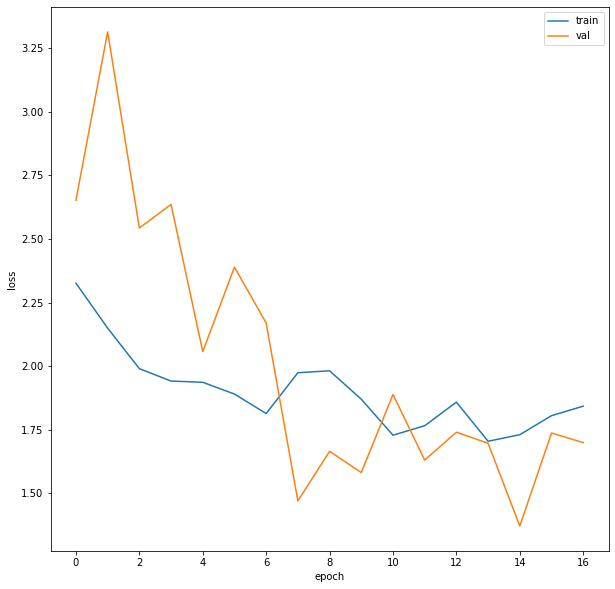

In [78]:
plt.plot(results['train'], label='train')
plt.plot(results['val'], label='val')
plt.xlabel('epoch')
plt.ylabel('loss')
plt.legend()
plt.show()